# Multimodal Search

In [1]:
!pip install widgetsnbextension

In [1]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [4]:
%pip install git+https://github.com/huggingface/transformers

  Cloning https://github.com/huggingface/transformers to /tmp/pip-req-build-gvr3tq6v
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers /tmp/pip-req-build-gvr3tq6v
  Resolved https://github.com/huggingface/transformers to commit 1de8ce9ee1191ba761a593ac15d9ccbf5851bfc5
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for transformers: filename=transformers-4.28.0.dev0-py3-none-any.whl size=6895453 sha256=2d5a30262a7f344c67df6c0e863a7a051c890eb81d13186b85c2ae4da2e53d1c
  Stored in directory: /tmp/pip-ephem-wheel-cache-j8bqr0e1/wheels/14/a0/7b/8f6b25ba4110aa215fcb8d6aedd6cd4f9b9b6619190999ac2b
Successfully built transformers
  Attempting uninstall: transformers
    Found existing installation: transformers 4.27.4
    Uninstalling transformers-4.27.4:
      Successfully uninstalled transformers-4.27

# All imports


In [2]:
# https://huggingface.co/datasets/detection-datasets/coco
import torch
from datasets import load_from_disk
from datasets import load_dataset

from transformers import AutoFeatureExtractor, CvtForImageClassification
from transformers import ViTModel

from transformers import AutoFeatureExtractor, AutoModel
import torchvision.transforms as T

import os
import shutil
import matplotlib.pyplot as plt

import PIL
import requests
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler
import gradio as gr
from PIL import Image
from sys import platform

import matplotlib.image as mpimg
device = "cpu"
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(torch.cuda.is_available())
print(device)


/home/amarinov/miniconda3/envs/multimodal-search/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/amarinov/miniconda3/envs/multimodal-search/lib/python3.9/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /home/amarinov/miniconda3/envs/multimodal-search/lib/python3.9/site-packages/torchvision/image.so: undefined symbol: _ZN3c106detail19maybe_wrap_dim_slowEllb
  warn(f"Failed to load image Python extension: {e}")


cpu


In [3]:

# RUN ONCE
print("loading dataset")


if platform == "linux" or platform == "linux2":
    # linux
    dataset = load_dataset("detection-datasets/coco", cache_dir="/data/volume_2/datasets/")
elif platform == "darwin":
    # OS X
    dataset = load_dataset("detection-datasets/coco")
elif platform == "win32":
    # Windows...
    dataset = load_dataset("detection-datasets/coco")


# https://huggingface.co/blog/image-similarity


print("loading model 4")
model = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
print("loading model to device")
model.to(device)
print("model downloaded")



loading dataset


Found cached dataset parquet (/data/volume_2/datasets/detection-datasets___parquet/detection-datasets--coco-64ef6d5414f6b8df/0.0.0/2a3b91fbd88a2c90d1dbbb32b460cf621d31bd5b05b934492fdef7d8d6f236ec)
100%|████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 215.72it/s]


loading model 4
loading model to device
model downloaded


In [4]:
# RUN ONCE

num_samples = 100
seed = 42
print("load dataset again")
if platform == "linux" or platform == "linux2":
    # linux
    dataset = load_dataset("detection-datasets/coco", cache_dir="/data/volume_2/datasets/")
elif platform == "darwin":
    # OS X
    dataset = load_dataset("detection-datasets/coco")
elif platform == "win32":
    # Windows...
    dataset = load_dataset("detection-datasets/coco")


dataset = dataset["train"]

# dataset = dataset["train"].shuffle(seed=seed).select(range(num_samples))
print("initialise")
dataset.__len__()

load dataset again


Found cached dataset parquet (/data/volume_2/datasets/detection-datasets___parquet/detection-datasets--coco-64ef6d5414f6b8df/0.0.0/2a3b91fbd88a2c90d1dbbb32b460cf621d31bd5b05b934492fdef7d8d6f236ec)
100%|████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 230.34it/s]

initialise


117266

In [5]:
# THIS IS FAST

print("imported torchvision.transforms as T")


if platform == "linux" or platform == "linux2":
    # linux
    extractor = AutoFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k', cache_dir="/data/volume_2/datasets/")
elif platform == "darwin":
    # OS X
    extractor = AutoFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')
elif platform == "win32":
    # Windows...
    extractor = AutoFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')



model_input_size = 224
# Data transformation chain.
print("transforming data")
transformation_chain = T.Compose(
    [
        # use https://huggingface.co/microsoft/cvt-21-384 
        T.Resize(model_input_size),
        T.CenterCrop(model_input_size),
        T.ToTensor(),
        T.Normalize(mean=extractor.image_mean, std=extractor.image_std),
        
    ]
)
print("transformed data")

imported torchvision.transforms as T
transforming data
transformed data


/home/amarinov/miniconda3/envs/multimodal-search/lib/python3.9/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [6]:

# RUN ONCE 
# ------------------------------------------------------------
# ONCE THIS IS DONE, YOU CAN RUN THE PIPELINE
print("imported os, shutil")
def extract_embeddings(model: torch.nn.Module):
    """Utility to compute embeddings."""
    device = model.device
    print("extracting embeddings")
    def pp(batch):
        images = batch["image"]
        # do not forget to convert to RGB
        # print("extracting embeddings torch stack")
        images = torch.stack([transformation_chain(image.convert('RGB')) for image in images])
        # print("extracting embeddings to device")
        images = images.to(device)

        with torch.no_grad():
            # print("extracting embeddings model")
            embeddings = model(images)
            # 0 because [CLS] token that represent the whole class https://github.com/huggingface/transformers/issues/16984
            embeddings = embeddings.last_hidden_state[:, 0]
            embeddings = embeddings.cpu()

            # print(embeddings.shape)
            return {"embeddings": embeddings}
    print("extracted embeddings pp")
    return pp



# ------------------------------------------------------------
# ONCE THIS IS DONE, YOU CAN RUN THE PIPELINE

imported os, shutil


In [7]:

# ! COMMENTED OUT SINCE WE HAVE ALREADY RUN THIS
# RUN ONCE - THIS SAVES TO DISK - sometimes you can get away without doing this after restarting the kernel
# ------------------------------------------------------------
# ONCE THIS IS DONE, YOU CAN RUN THE PIPELINE

# if memory is an issue, you can use a smaller batch size
# batch_size = 32
# print("extracting embeddings main")
# extract_fn = extract_embeddings(model.to(device))

# save_path = "./data/coco_embeddings"


# # if coco embedding dataset is not on disk, do map
# # if not os.path.exists(save_path):
# print("mapping dataset")
# dataset_emb = dataset.map(extract_fn, batched=True, batch_size=batch_size)
# if os.path.exists(save_path):
#     print("removing old dataset")
#     shutil.rmtree(save_path)

# print("saving dataset")
# dataset_emb.save_to_disk(save_path)
# print("dataset saved")
# ------------------------------------------------------------
# ONCE THIS IS DONE, YOU CAN RUN THE PIPELINE

In [8]:

# THIS IS FAST
# https://huggingface.co/course/chapter5/6?fw=pt#using-faiss-for-efficient-similarity-search
save_path = "./data/coco_embeddings"
dataset_emb = load_from_disk(save_path)
print("dataset loaded")
# print(dataset_emb["embeddings"])
print(dataset_emb.__len__())

dataset_emb.add_faiss_index(column="embeddings")

dataset loaded
117266


100%|████████████████████████████████████████████████████████████████████████████| 118/118 [00:00<00:00, 267.15it/s]


Dataset({
    features: ['image_id', 'image', 'width', 'height', 'objects', 'embeddings'],
    num_rows: 117266
})

In [9]:
def get_embeddings(image):
    image = transformation_chain(image.convert('RGB'))
    image = torch.stack([image])
    image = image.to(device)
    with torch.no_grad():
        embeddings = model(image)
        embeddings = embeddings.last_hidden_state[:, 0].cpu()
        print(embeddings.shape)
        embeddings = embeddings.squeeze(0)
        return embeddings

torch.Size([1, 768])


torch.Size([768])

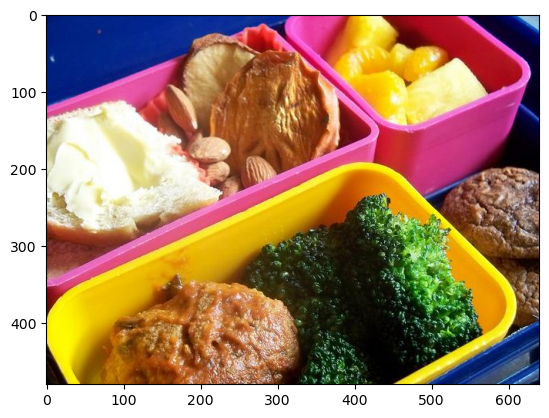

In [10]:
# THIS IS FOR TESTING
image = dataset_emb[0]["image"]

# print image
import matplotlib.pyplot as plt
plt.imshow(image)

question_embedding = get_embeddings(image)
question_embedding.shape

In [11]:
# Define emebdding retrieval functions

def get_nearest_examples(embedding, how_many=5):
    return dataset_emb.get_nearest_examples("embeddings", embedding.numpy(), k=how_many)

def plot_nearest_samples(samples, how_many=5):

    sample_images = samples["image"]

    fig, axs = plt.subplots(1, how_many, figsize=(20, 20))
    for i, ax in enumerate(axs):
        ax.imshow(sample_images[i])
        ax.axis("off")
    plt.show()


In [12]:
# THIS IS FOR TESTING
# TAKES ABOUT 20-25 SECONDS
from datetime import datetime

now = datetime.now()

current_time = now.strftime("%H:%M:%S")
print("Current Time =", current_time)

print(torch.tensor(dataset_emb["embeddings"][32]).shape)

scores, samples = get_nearest_examples(question_embedding)
print(scores)
plot_nearest_samples(samples)

now_finish = datetime.now()

current_time = now_finish.strftime("%H:%M:%S")
print("Current Time =", current_time)

Current Time = 13:52:50


KeyboardInterrupt: 

## Pix2Pix

In [13]:
# TAKES ABOUT 20-25 SECONDS

# https://huggingface.co/timbrooks/instruct-pix2pix
model_id = "timbrooks/instruct-pix2pix"
print("Loading model...")
if platform == "linux" or platform == "linux2":
    # linux
    pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, safety_checker=None, cache_dir="/data/volume_2/datasets/")
elif platform == "darwin":
    # OS X
    pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float32, safety_checker=None)

elif platform == "win32":
    # Windows...
    pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float32, safety_checker=None)



print("Model loaded successfully!")
pipe.to(device)
print("Model moved to MPS successfully!")
pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)
print("Scheduler loaded successfully!")





Loading model...


Fetching 15 files: 100%|████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 120525.98it/s]


Model loaded successfully!
Model moved to MPS successfully!
Scheduler loaded successfully!


In [14]:
def download_image(url):
    print("Downloading image...")
    image = PIL.Image.open(requests.get(url, stream=True).raw)
    print("Image opened successfully!")
    image = PIL.ImageOps.exif_transpose(image)
    print("transposed successfully!")
    image = image.convert("RGB")
    print(f"Image size: {image.size}")
    print("Image downloaded successfully!")
    image 
    return image

Image opened successfully!
transposed successfully!
Image size: (512, 512)
Image downloaded successfully!


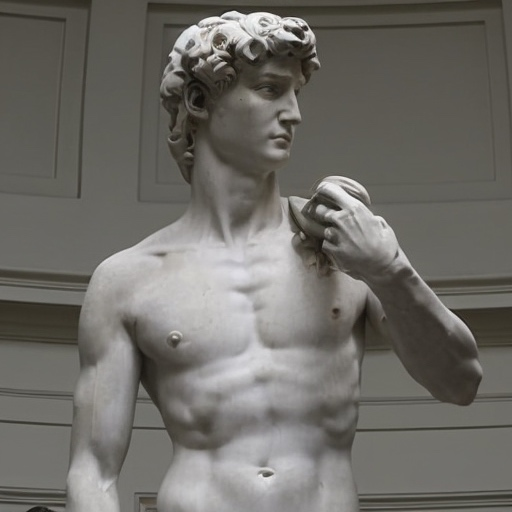

In [15]:
# THIS IS FOR TESTING
# This downloads the image - FAST
url = "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg"

image_david = download_image(url)
image_david

In [18]:
# !pip install torch torchvision --extra-index-url https://download.pytorch.org/whl/rocm5.1.1 

# !python3 launch.py --precision full --no-half

100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:57<00:00,  5.74s/it]


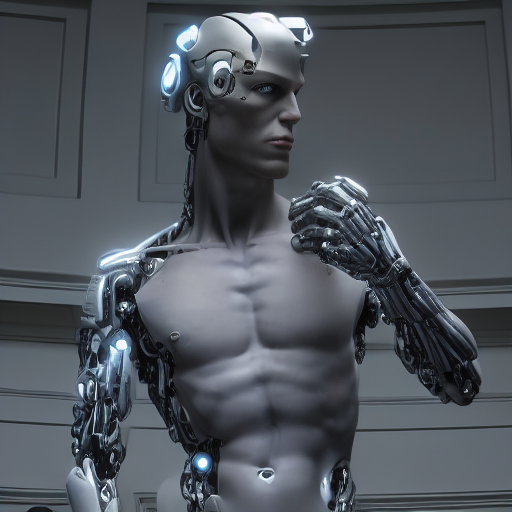

In [19]:
# THIS IS FOR TESTING
# This runs the image through the model
# TAKES ABOUT 20-25 SECONDS
# ! VERY RESOURCE INTENSIVE ! - Actually scales with the image size/dimensions
# ! NOT RECOMMENDED TO RUN ANYTHING ELSE WHILE THIS IS RUNNING !
prompt = "turn him into cyborg"
images_david_diffused = pipe(prompt, image=image_david, num_inference_steps=10, image_guidance_scale=1).images
images_david_diffused[0]

In [ ]:
images_david_diffused[0].save("./diffused_images/test.png")

torch.Size([1, 768])


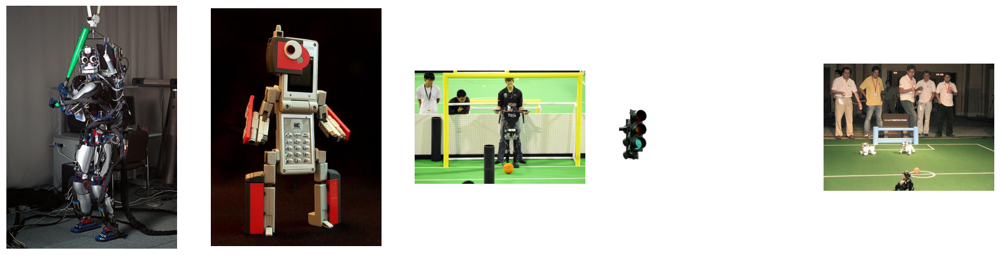

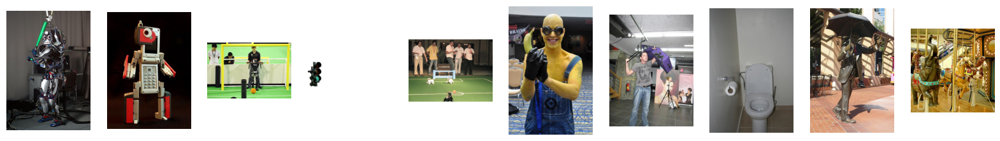

In [20]:
# THIS IS FOR TESTING
# FAST
# This gives us the closest images to the output of the model
pix2pix_embedding = get_embeddings(images_david_diffused[0])

pix2pix_scores, pix2pix_samples  = get_nearest_examples(pix2pix_embedding, how_many=10)

plot_nearest_samples(pix2pix_samples)
plot_nearest_samples(pix2pix_samples, how_many=10)

def plot_nearest_samples(samples, how_many=5):

    sample_images = samples["image"]

    fig, axs = plt.subplots(1, how_many, figsize=(20, 20))
    for i, ax in enumerate(axs):
        ax.imshow(sample_images[i])
        ax.axis("off")
    plt.show()

## UI

In [18]:
# CAPTIONING IMAGES
# We use this to try and convert the images into a textual output
# That way we can evaluate them as documents
# https://huggingface.co/nlpconnect/vit-gpt2-image-captioning
# from transformers import VisionEncoderDecoderModel, ViTImageProcessor, AutoTokenizer
# import torch
# from PIL import Image


# if platform == "linux" or platform == "linux2":
#     # linux
# #     pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None, cache_dir="/data/volume_2/datasets/")
#     model_caption = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning", cache_dir="/data/volume_2/datasets/").to(device)
# elif platform == "darwin":
#     # OS X
#     model_caption = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning").to(device)

# elif platform == "win32":
#     # Windows...
#     model_caption = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning").to(device)

# model_caption = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning").to(device)
# feature_extractor_caption = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
# tokenizer_caption = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

# device_for_caption = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model_caption.to(device_for_caption)

In [44]:
######################
# IMAGE CAPTIONING
######################
# max_length = 24
# num_beams = 2
# gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
# def predict_caption(images):
#   # mps is not supported yet
#   pixel_values = feature_extractor_caption(images=images, return_tensors="pt").pixel_values.to("cpu")

#   output_ids = model_caption.generate(pixel_values, **gen_kwargs)

#   preds = tokenizer_caption.batch_decode(output_ids, skip_special_tokens=True)
#   preds = [pred.strip() for pred in preds]
#   return preds


# caption_david = predict_caption([image_david])
# caption_david_diffused = predict_caption([images_diffused[0]])
# caption_result_1 = predict_caption(pix2pix_samples["image"][0])

# print(caption_david)
# print(caption_david_diffused)
# print(caption_result_1)


['a man in a white shirt is holding a white object']
['a colorful bird is standing on top of a green plant']
['a baseball player holding a bat in a room']


In [17]:
######################
# IMAGE CAPTIONING 2
######################
import requests
from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration

if platform == "linux" or platform == "linux2":
    # linux
#     pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None, cache_dir="/data/volume_2/datasets/")
    processor_blip = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large", cache_dir="/data/volume_2/datasets/")
    model_blip = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large", cache_dir="/data/volume_2/datasets/")
elif platform == "darwin":
    # OS X
    processor_blip = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large")
    model_blip = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large")
elif platform == "win32":
    # Windows...
    processor_blip = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large")
    model_blip = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large")



# img_url = 'https://storage.googleapis.com/sfr-vision-language-research/BLIP/demo.jpg' 
# raw_image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')

# raw_image = images_david_diffused[0]

# # conditional image captioning
# text = "a photography of"
# inputs = processor_blip(raw_image, text, return_tensors="pt")

# out = model_blip.generate(**inputs)
# print(processor_blip.decode(out[0], skip_special_tokens=True))

# # unconditional image captioning
# inputs = processor_blip(raw_image, return_tensors="pt")

# out = model_blip.generate(**inputs)
# print(processor_blip.decode(out[0], skip_special_tokens=True))

In [18]:
def predict_caption_blip(raw_image):
    # conditional image captioning
    text = "a picture of"
    inputs = processor_blip(raw_image, text, return_tensors="pt")

    out = model_blip.generate(**inputs)

    prediction = processor_blip.decode(out[0], skip_special_tokens=True)
    return prediction.split("a picture of ")[1].replace(",", "")


In [23]:
caption_david = predict_caption_blip([image_david])
caption_david_diffused = predict_caption_blip([images_david_diffused[0]])
caption_result_1 = predict_caption_blip(pix2pix_samples["image"][0])

print(caption_david)
print(caption_david_diffused)
print(caption_result_1)


a statue of a man holding a apple
a robot with a head light on
a robot with a green bat in his hand


In [19]:
######################
# SENTENCE SIMILARITY
######################

# This is used to compare the captions of the images -> this is our score for document similarity
# https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2
from sentence_transformers import SentenceTransformer, util
# sentences = ["This is an example sentence", "example of another sentence"]

model_sentences = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')
# embeddings_1 = model_sentences.encode(sentences[0])
# embeddings_2 = model_sentences.encode(sentences[1])
# cosine_score = util.cos_sim(embeddings_1, embeddings_2)

# david_caption_embedding = model_sentences.encode(caption_david)
# david_diffused_caption_embedding = model_sentences.encode(caption_david_diffused)
# result_1_caption_embedding = model_sentences.encode(caption_result_1)

# cosine_score = util.cos_sim(david_caption_embedding, david_diffused_caption_embedding)
# cosine_score_2 = util.cos_sim(david_caption_embedding, result_1_caption_embedding)
# cosine_score_3 = util.cos_sim(david_diffused_caption_embedding, result_1_caption_embedding)

# print(cosine_score)
# print(cosine_score_2)
# print(cosine_score_3)

# print(str(cosine_score.item()))

In [20]:
# define a function to compare the captions of the images -> this is our score for document similarity
def compare_captions(caption_1, caption_2):
    caption_1_embedding = model_sentences.encode(caption_1)
    caption_2_embedding = model_sentences.encode(caption_2)
    cosine_score = util.cos_sim(caption_1_embedding, caption_2_embedding)
    return cosine_score.item()

In [33]:
####################
# MODIFIED PIPELINE
####################


####################
# RESIZE IMAGES
####################
# Get all the query images from the folder
# Resize the images to 256x256
# Save the resized images to a folder
original_images_folder = "./query_images"
resized_images_folder = "./resized_images"
size = 256, 256
for image_name in [ x for x in sorted(os.listdir(original_images_folder)) if ".DS_Store" not in x ]:
    print("Resizing: " + image_name)
    img = Image.open(os.path.join(original_images_folder,image_name))
    # img = img.resize((256,256))
    img.thumbnail(size, Image.LANCZOS)
    img.save(os.path.join(resized_images_folder,image_name))

# Get image caption
#     image_caption = predict_caption_blip([img])
#     print(image_caption)







Resizing: 01_black_cat.jpg
a black cat standing in a grassy field
Resizing: 02_elephant_on_safari.jpg
an elephant walking on a dirt road in the wild
Resizing: 03_old_abandoned_car.jpg
an old car is sitting in the woods
Resizing: 04_green_vintage_racecar.jpg
a green race car with yellow wheels driving down a track
Resizing: 05_man_wearing_white_t-shirt.jpg
a man in a white shirt is standing
Resizing: 06_red_tall_converse.jpg
a person wearing red converses standing on a grass covered field
Resizing: 07_hand_holding_iphone.jpg
a person holding a cell phone in their hand
Resizing: 08_opened_laptop_on_a_table.jpg
a laptop computer sitting on top of a wooden table
Resizing: 09_katana_in_a_sheath.jpg
a wooden baseball bat laying on a wooden floor
Resizing: 10_hand_holding_a_gun.jpg
a person holding a gun in their hand
Resizing: 11_eiffel_tower_in_daylight.jpg
a very tall tower sitting in the middle of a park
Resizing: 12_pyramid_in_a_desert.jpg
a large pyramid with a few buses parked in front

In [21]:
###########################
# CAPTION RESIZED IMAGES
###########################
# Get captions for all resized images
resized_images_folder = "./resized_images"
original_images_captions_file = "./captions/original_images_captions.txt"
resized_images_captions = []
for image_name in [ x for x in sorted(os.listdir(resized_images_folder)) if ".DS_Store" not in x ]:

    print("Captioning: " + image_name)
    img = Image.open(os.path.join(resized_images_folder,image_name))
    image_caption = predict_caption_blip(img)
    print(image_caption)
    resized_images_captions.append(image_caption)

    # Save the captions to a file
    with open(original_images_captions_file, 'w') as f:
        for item in resized_images_captions:
            f.write(item)
            f.write("\n")


Captioning: 01_black_cat.jpg


/home/amarinov/miniconda3/envs/multimodal-search/lib/python3.9/site-packages/transformers/generation/utils.py:1313: UserWarning: Using `max_length`'s default (20) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


a black cat standing in a grassy field
Captioning: 02_elephant_on_safari.jpg
an elephant walking on a dirt road in the wild
Captioning: 03_old_abandoned_car.jpg
an old car is sitting in the woods
Captioning: 04_green_vintage_racecar.jpg
a green race car driving down a track
Captioning: 05_man_wearing_white_t-shirt.jpg
a man in a white shirt and black jeans
Captioning: 06_red_tall_converse.jpg
a person wearing red converses standing on a grass field
Captioning: 07_hand_holding_iphone.jpg
a person holding a cell phone in their hand
Captioning: 08_opened_laptop_on_a_table.jpg
a laptop computer sitting on top of a wooden table
Captioning: 09_katana_in_a_sheath.jpg
a baseball bat laying on a wooden surface
Captioning: 10_hand_holding_a_gun.jpg
a person holding a gun in their hand
Captioning: 11_eiffel_tower_in_daylight.jpg
a view of the eiffel tower from the park
Captioning: 12_pyramid_in_a_desert.jpg
a large pyramid with a truck parked in front of it
Captioning: 13_daisy_flower.jpg
a singl

In [22]:
module_path = os.path.abspath(os.path.join('./prompts'))
from prompts.query_prompts import query_prompts_for_diffusion
from prompts.query_prompts import query_prompts_for_input_images
%load_ext autoreload
%autoreload 2

# import prompts.query_prompts

# reload(prompts.query_prompts)

# prompts.reload(query_prompts)
# query_prompts_for_diffusion

prompts = query_prompts_for_input_images
print(prompts)

['make this cat lick itself', 'put this elephant in the zoo', 'make this car new and clean', 'turn the race car red color', 'turn the t-shirt rainbow colors', 'make these converse boots low', 'put this iPhone on a table', 'close  the laptop lid', 'take this katana out of the sheath', 'make this person hold two guns', 'show Eiffel Tower at night', 'put camels next to the pyramid', 'move this flower to a desert', 'add tepals to the cacti', "solve this Rubik's cube", "make this Rubik's cube 4 by 4 size", 'put the hot air balloon on sand', 'show only one white and red hot air balloon', 'make this jack Daniels whiskey instead', 'make this beer glass half empty', 'make this ferrari yellow', 'make this lamborghini a faster model', 'remove the fur from this dog', 'make this pug darker fur and smile less']


QUERY PROMPTS: ['make this cat lick itself', 'put this elephant in the zoo', 'make this car new and clean', 'turn the race car red color', 'turn the t-shirt rainbow colors', 'make these converse boots low', 'put this iPhone on a table', 'close  the laptop lid', 'take this katana out of the sheath', 'make this person hold two guns', 'show Eiffel Tower at night', 'put camels next to the pyramid', 'move this flower to a desert', 'add tepals to the cacti', "solve this Rubik's cube", "make this Rubik's cube 4 by 4 size", 'put the hot air balloon on sand', 'show only one white and red hot air balloon', 'make this jack Daniels whiskey instead', 'make this beer glass half empty', 'make this ferrari yellow', 'make this lamborghini a faster model', 'remove the fur from this dog', 'make this pug darker fur and smile less']
Diffusing: 01_black_cat.jpg with prompt: make this cat lick itself
Prompt: make this cat lick itself


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.60it/s]


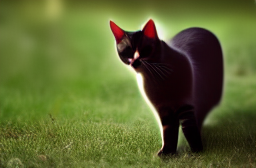

Diffusing: 02_elephant_on_safari.jpg with prompt: put this elephant in the zoo
Prompt: put this elephant in the zoo


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.51it/s]


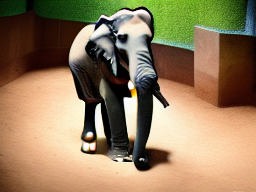

Diffusing: 03_old_abandoned_car.jpg with prompt: make this car new and clean
Prompt: make this car new and clean


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.60it/s]


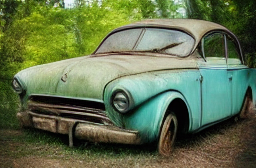

Diffusing: 04_green_vintage_racecar.jpg with prompt: turn the race car red color
Prompt: turn the race car red color


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.56it/s]


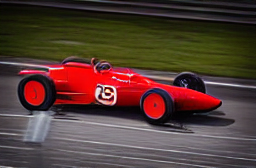

Diffusing: 05_man_wearing_white_t-shirt.jpg with prompt: turn the t-shirt rainbow colors
Prompt: turn the t-shirt rainbow colors


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:08<00:00,  1.23it/s]


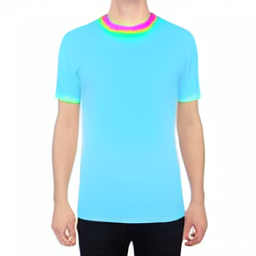

Diffusing: 06_red_tall_converse.jpg with prompt: make these converse boots low
Prompt: make these converse boots low


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.59it/s]


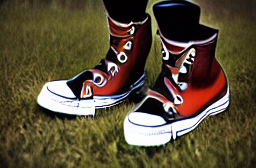

Diffusing: 07_hand_holding_iphone.jpg with prompt: put this iPhone on a table
Prompt: put this iPhone on a table


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.58it/s]


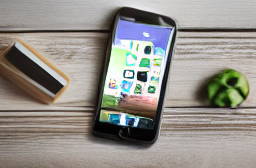

Diffusing: 08_opened_laptop_on_a_table.jpg with prompt: close  the laptop lid
Prompt: close  the laptop lid


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.51it/s]


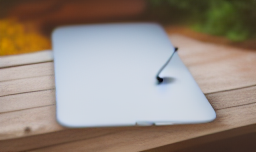

Diffusing: 09_katana_in_a_sheath.jpg with prompt: take this katana out of the sheath
Prompt: take this katana out of the sheath


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:05<00:00,  1.75it/s]


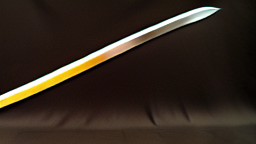

Diffusing: 10_hand_holding_a_gun.jpg with prompt: make this person hold two guns
Prompt: make this person hold two guns


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.57it/s]


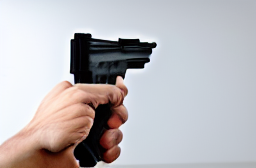

Diffusing: 11_eiffel_tower_in_daylight.jpg with prompt: show Eiffel Tower at night
Prompt: show Eiffel Tower at night


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.51it/s]


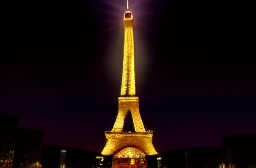

Diffusing: 12_pyramid_in_a_desert.jpg with prompt: put camels next to the pyramid
Prompt: put camels next to the pyramid


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.57it/s]


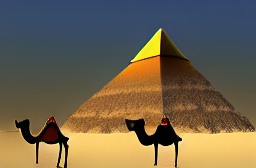

Diffusing: 13_daisy_flower.jpg with prompt: move this flower to a desert
Prompt: move this flower to a desert


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.66it/s]


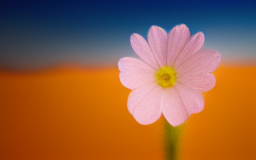

Diffusing: 14_cacti.jpg with prompt: add tepals to the cacti
Prompt: add tepals to the cacti


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.60it/s]


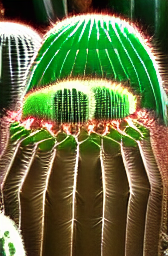

Diffusing: 15_scrambled_rubiks_cube_3_by_3.jpg with prompt: solve this Rubik's cube
Prompt: solve this Rubik's cube


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.58it/s]


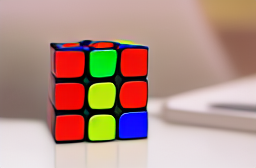

Diffusing: 16_solved_rubiks_cube_2_by_2.jpg with prompt: make this Rubik's cube 4 by 4 size
Prompt: make this Rubik's cube 4 by 4 size


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:07<00:00,  1.32it/s]


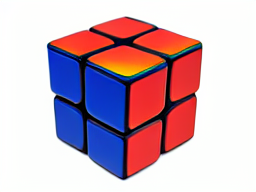

Diffusing: 17_hot_air_balloon_over_water_at_night.jpg with prompt: put the hot air balloon on sand
Prompt: put the hot air balloon on sand


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.57it/s]


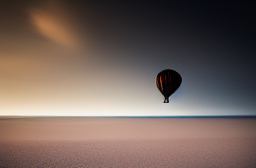

Diffusing: 18_many_hot_air_balloons.jpg with prompt: show only one white and red hot air balloon
Prompt: show only one white and red hot air balloon


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.58it/s]


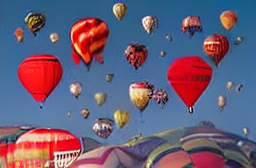

Diffusing: 19_tullamore_dew_bottle_with_two_glasses.jpg with prompt: make this jack Daniels whiskey instead
Prompt: make this jack Daniels whiskey instead


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.58it/s]


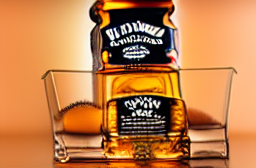

Diffusing: 20_full_beer_glass.jpg with prompt: make this beer glass half empty
Prompt: make this beer glass half empty


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.57it/s]


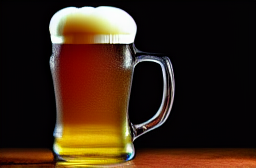

Diffusing: 21_red_ferrari.jpg with prompt: make this ferrari yellow
Prompt: make this ferrari yellow


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:05<00:00,  1.78it/s]


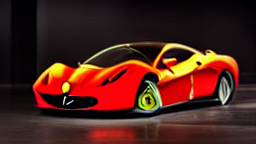

Diffusing: 22_yellow_lamborghini.jpg with prompt: make this lamborghini a faster model
Prompt: make this lamborghini a faster model


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.58it/s]


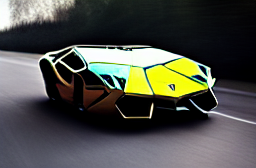

Diffusing: 23_fluffy_fox_dog.jpeg with prompt: remove the fur from this dog
Prompt: remove the fur from this dog


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.57it/s]


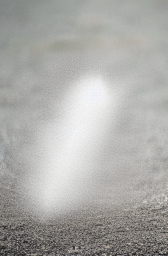

Diffusing: 24_pug_smiling_on_grass.jpg with prompt: make this pug darker fur and smile less
Prompt: make this pug darker fur and smile less


100%|███████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.52it/s]


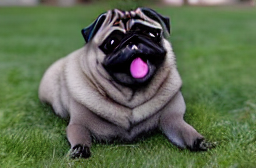

In [23]:

####################
# DIFFUSE IMAGES
####################
# Get all the query prompts from the file
# Run the resized query images through the model using the query prompts
# Save the output images to a folder (diffused_images)
import sys
resized_images_folder = "./resized_images"
diffused_images_folder = "./diffused_images"

if module_path not in sys.path:
    sys.path.append(module_path)

print("QUERY PROMPTS: " + str(prompts))

for index, image_name in enumerate([ x for x in sorted(os.listdir(resized_images_folder)) if ".DS_Store" not in x ]):
    print("Diffusing: " + image_name + " with prompt: " + prompts[index])
    image = Image.open(os.path.join(resized_images_folder,image_name))
    # for prompt in query_prompts_for_diffusion:
    prompt = prompts[index]
    print("Prompt: " + prompt)
    images_diffused = pipe(prompt, image=image, num_inference_steps=10, image_guidance_scale=1).images
    images_diffused[0].save(os.path.join(diffused_images_folder, image_name.split(".")[0] + "_" + prompt.replace(" ", "_") + ".jpeg"))
    display(images_diffused[0])



Captioning: 01_black_cat_make_this_cat_lick_itself.jpeg


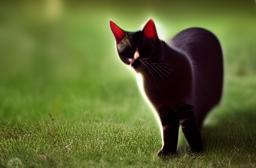

a black cat standing on top of a lush green field
Captioning: 02_elephant_on_safari_put_this_elephant_in_the_zoo.jpeg


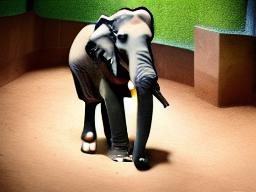

a toy elephant standing in a room with a green wall
Captioning: 03_old_abandoned_car_make_this_car_new_and_clean.jpeg


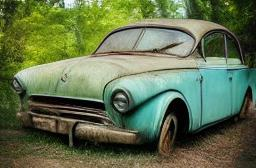

an old car is parked in the woods
Captioning: 04_green_vintage_racecar_turn_the_race_car_red_color.jpeg


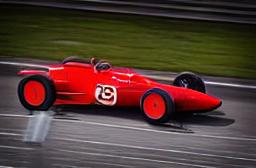

a red race car driving down a track
Captioning: 05_man_wearing_white_t-shirt_turn_the_t-shirt_rainbow_colors.jpeg


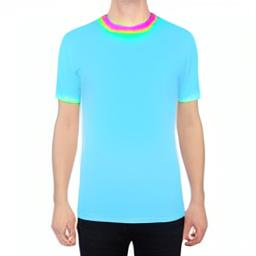

a man in a blue shirt and black pants
Captioning: 06_red_tall_converse_make_these_converse_boots_low.jpeg


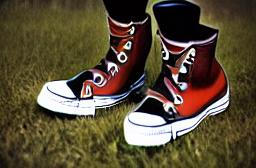

a pair of red and black sneakers on a grassy field
Captioning: 07_hand_holding_iphone_put_this_iPhone_on_a_table.jpeg


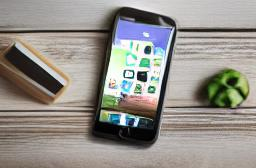

a cell phone sitting next to a green apple
Captioning: 08_opened_laptop_on_a_table_close__the_laptop_lid.jpeg


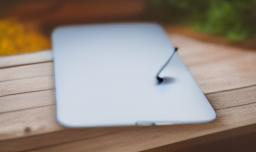

a tablet computer sitting on top of a wooden table
Captioning: 09_katana_in_a_sheath_take_this_katana_out_of_the_sheath.jpeg


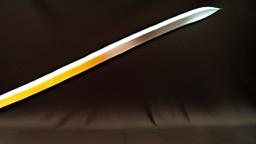

a knife with a yellow handle on a black background
Captioning: 10_hand_holding_a_gun_make_this_person_hold_two_guns.jpeg


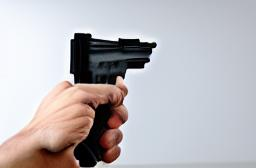

a person holding a gun in their hand
Captioning: 11_eiffel_tower_in_daylight_show_Eiffel_Tower_at_night.jpeg


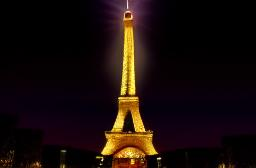

a very tall tower lit up at night
Captioning: 12_pyramid_in_a_desert_put_camels_next_to_the_pyramid.jpeg


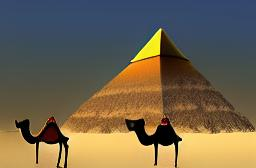

three camels are standing in front of a pyramid
Captioning: 13_daisy_flower_move_this_flower_to_a_desert.jpeg


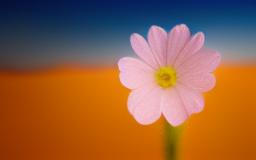

a single pink flower in a vase on a table
Captioning: 14_cacti_add_tepals_to_the_cacti.jpeg


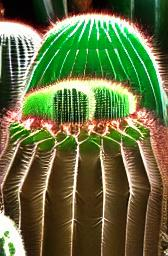

a cactus with a green hat on top of it
Captioning: 15_scrambled_rubiks_cube_3_by_3_solve_this_Rubik's_cube.jpeg


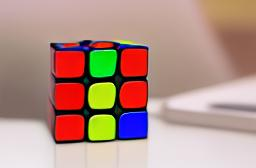

a rubik cube sitting on top of a table
Captioning: 16_solved_rubiks_cube_2_by_2_make_this_Rubik's_cube_4_by_4_size.jpeg


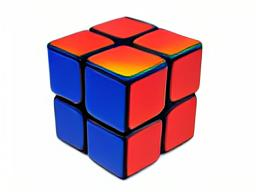

a rubik cube with a red blue and yellow top
Captioning: 17_hot_air_balloon_over_water_at_night_put_the_hot_air_balloon_on_sand.jpeg


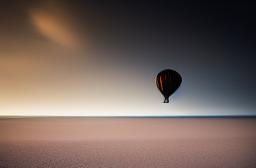

a hot air balloon flying over a beach
Captioning: 18_many_hot_air_balloons_show_only_one_white_and_red_hot_air_balloon.jpeg


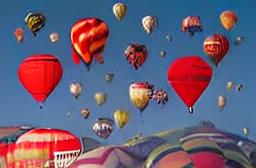

a bunch of balloons flying in the sky
Captioning: 19_tullamore_dew_bottle_with_two_glasses_make_this_jack_Daniels_whiskey_instead.jpeg


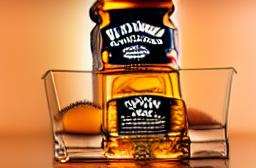

a bottle of whiskey sitting on top of a glass
Captioning: 20_full_beer_glass_make_this_beer_glass_half_empty.jpeg


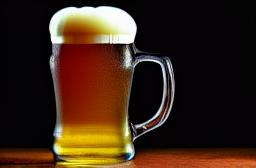

a glass of beer on a table
Captioning: 21_red_ferrari_make_this_ferrari_yellow.jpeg


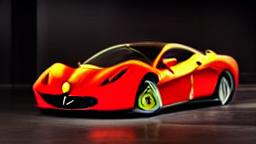

a red sports car is shown in a dark room
Captioning: 22_yellow_lamborghini_make_this_lamborghini_a_faster_model.jpeg


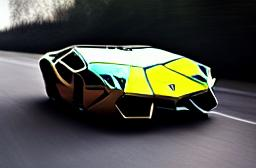

a car that is sitting on the side of the road
Captioning: 23_fluffy_fox_dog_remove_the_fur_from_this_dog.jpeg


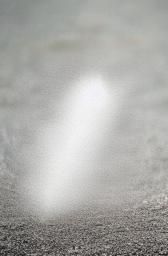

a small bird is standing on the ground
Captioning: 24_pug_smiling_on_grass_make_this_pug_darker_fur_and_smile_less.jpeg


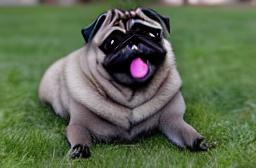

a pug dog laying on the grass with a pink ball in its mouth


In [24]:
###########################
# CAPTION DIFFUSED IMAGES
###########################
# Get captions for all diffused images
diffused_images_folder = "./diffused_images"
diffused_images_captions_file = "./captions/diffused_images_captions.txt"
diffused_images_captions = []
for image_name in [ x for x in sorted(os.listdir(diffused_images_folder)) if ".DS_Store" not in x ]:
    print("Captioning: " + image_name)
    img = Image.open(os.path.join(diffused_images_folder,image_name))
    image_caption = predict_caption_blip(img)
    display(img)
    print(image_caption)
    diffused_images_captions.append(image_caption)

    # Save the captions to a file
    with open(diffused_images_captions_file, 'w') as f:
        for item in diffused_images_captions:
            f.write(item)
            f.write("\n")

Finding similar images for: 01_black_cat_make_this_cat_lick_itself.jpeg


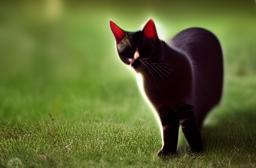

torch.Size([1, 768])


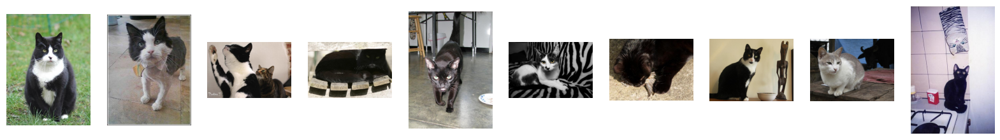

a black and white cat sitting in the grass
a cat with a tie on standing on a tiled floor
a cat is reaching up to a cat
a black cat laying on a wooden bench
a black cat walking on a floor next to a plate
a cat sitting on a zebra print couch
a black cat is laying on the ground
a black and white cat sitting on a table next to a bowl of food
a cat sitting on a table next to a cow
a black cat sitting on a stove top
Finding similar images for: 02_elephant_on_safari_put_this_elephant_in_the_zoo.jpeg


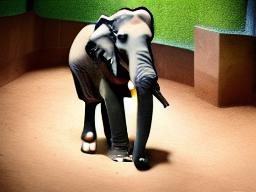

torch.Size([1, 768])


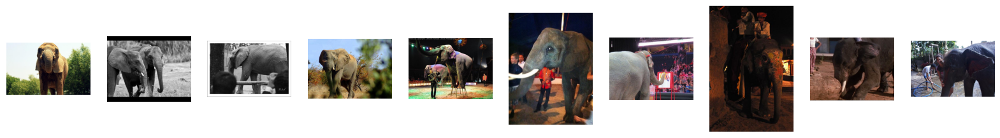

an elephant standing in a dirt field with trees in the background
two elephants are standing in a field eating
a black and white photo of an elephant
an elephant walking through a field with trees in the background
a man standing next to two elephants in a circus
a man in a red jacket standing next to an elephant
an elephant is painting a picture on a canvas
a group of people riding on the back of an elephant
a man standing next to an elephant on a dirt ground
a woman washing an elephant with a hose
Finding similar images for: 03_old_abandoned_car_make_this_car_new_and_clean.jpeg


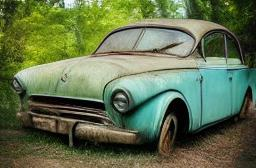

torch.Size([1, 768])


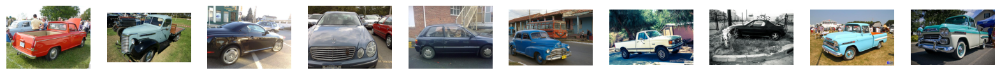

a red truck parked in a field with people standing around
a blue truck parked in a field with other cars
a black sports car parked in a parking lot
a blue mercedes parked in a parking lot
a dog is sitting in the passenger seat of a car
a blue car is parked on the side of the road
a white truck parked in a driveway next to a tree
a car is parked in a field next to a fire hydrant
a blue truck parked in a field with people standing around
a green and white truck parked in a parking lot
Finding similar images for: 04_green_vintage_racecar_turn_the_race_car_red_color.jpeg


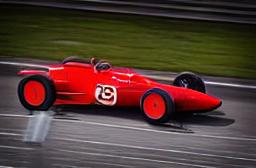

torch.Size([1, 768])


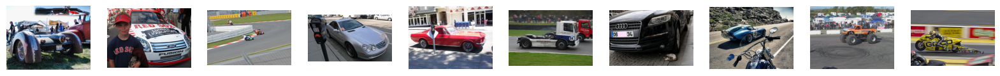

a car with a large tire parked in a field
a boy in a red sox shirt and a baseball cap stands in front of a
a group of motorcyclists racing around a track
a silver mercedes parked next to a parking meter
a red car parked next to a parking meter
a truck with a race car in the back
a cat laying on the ground next to a parked car
a blue sports car driving down a road next to a motorcycle
a monster truck is driving through a circle of tires
a person riding a motorcycle on a track
Finding similar images for: 05_man_wearing_white_t-shirt_turn_the_t-shirt_rainbow_colors.jpeg


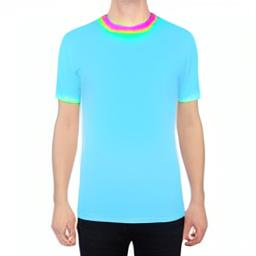

torch.Size([1, 768])


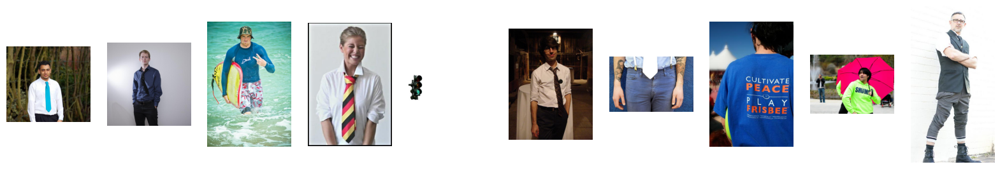

a man in a white shirt and blue tie
a man in a blue shirt and black tie
a man in a wet suit carrying a surfboard
a woman wearing a tie and smiling
a traffic light with a green light on it
a man in a white shirt and tie standing in a room
a man with a white tie and suspends
a man in a blue shirt is standing in front of a crowd
a man in a neon green shirt holding a pink umbrella
a man in a vest and tie standing with his arms crossed
Finding similar images for: 06_red_tall_converse_make_these_converse_boots_low.jpeg


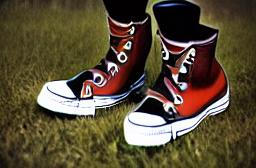

torch.Size([1, 768])


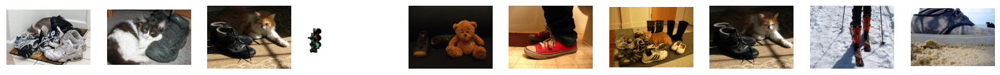

a cat laying on a mat next to a pile of shoes
a cat laying on a pair of shoes
a cat laying on the floor next to a pair of shoes
a traffic light with a green light on it
a teddy bear sitting next to a pair of shoes
a person standing on a toilet with red shoes
a cat laying on the floor next to a pile of shoes
a cat laying on the floor next to a pair of shoes
a person on skis standing in the snow
a pair of shoes sitting on top of a sandy beach
Finding similar images for: 07_hand_holding_iphone_put_this_iPhone_on_a_table.jpeg


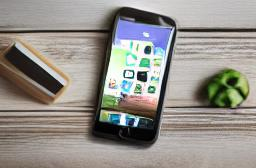

torch.Size([1, 768])


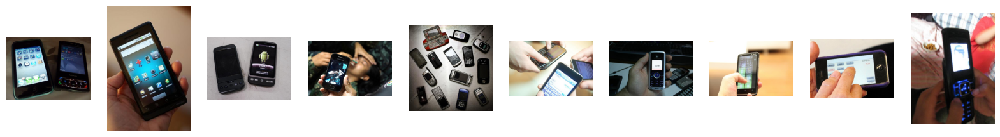

a couple of cell phones sitting next to each other
a person holding a smart phone in their hand
a black cell phone next to a black cell phone
a woman is holding a cell phone up to her face
a table with a bunch of different cell phones
a group of people holding up cell phones
a person holding a cell phone in their hand
a person holding a cell phone in their hand
a person holding a cell phone in their hand
a person holding a cell phone in their hand
Finding similar images for: 08_opened_laptop_on_a_table_close__the_laptop_lid.jpeg


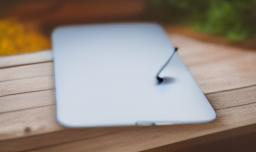

torch.Size([1, 768])


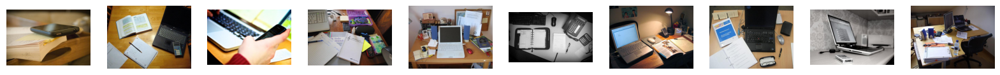

a cell phone sitting on top of a book
a laptop computer sitting on top of a wooden table
a person holding a cell phone in front of a laptop
a desk with a laptop notebook cell phone and other office supplies
a laptop computer sitting on top of a wooden desk
a desk with a keyboard a phone a calculator a notebook
a laptop computer sitting on top of a wooden desk
a laptop computer sitting on top of a wooden desk
a laptop computer sitting on top of a desk
a desk with a laptop a monitor and a phone
Finding similar images for: 09_katana_in_a_sheath_take_this_katana_out_of_the_sheath.jpeg


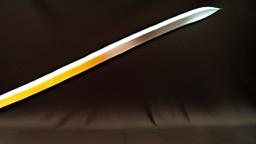

torch.Size([1, 768])


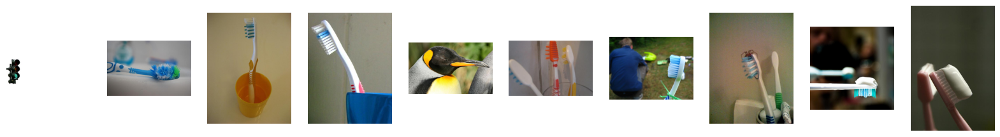

a traffic light with a green light on it
a toothbrush with a blue bristles and green bristles
a toothbrush in a yellow cup on a table
a toothbrush in a cup with a tooth brush in it
a close up of a penguin with a yellow beak
a cup with toothbrushes in it and a toothbrush holder
a man kneeling down next to a toothbrush
a couple of toothbrushes sitting in a cup
a toothbrush with toothpaste on it in front of a mirror
a toothbrush with a toothpaste on it
Finding similar images for: 10_hand_holding_a_gun_make_this_person_hold_two_guns.jpeg


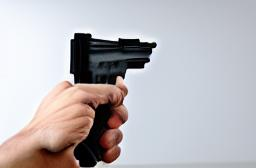

torch.Size([1, 768])


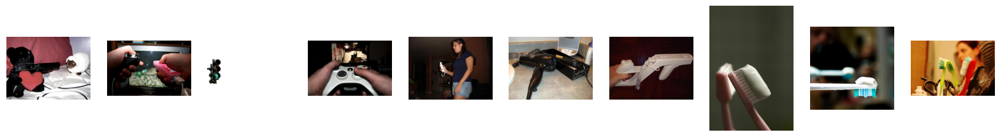

a stuffed animal holding a gun and a heart
two people holding remote controls in front of a tv
a traffic light with a green light on it
a person holding a video game controller in front of a tv
a woman standing in a living room holding a nintendo wii game controller
a hair dryer and a box on a counter
a person holding a wii controller in their hand
a toothbrush with a toothpaste on it
a toothbrush with toothpaste on it in front of a mirror
a woman is brushing her teeth in the mirror
Finding similar images for: 11_eiffel_tower_in_daylight_show_Eiffel_Tower_at_night.jpeg


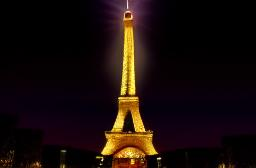

torch.Size([1, 768])


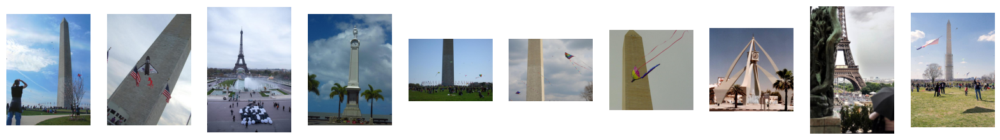

a woman standing in front of a tall monument
a kite flying in the air near a monument
a group of people standing around a fountain
a clock tower with palm trees in front of it
a crowd of people flying kites in front of the washington monument
a group of people flying kites in front of the washington monument
a kite flying in the air near a tall tower
a clock tower with a fountain in the middle of a street
a person holding an umbrella in front of the eiffel tower
a group of people flying kites in a park
Finding similar images for: 12_pyramid_in_a_desert_put_camels_next_to_the_pyramid.jpeg


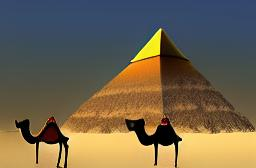

torch.Size([1, 768])


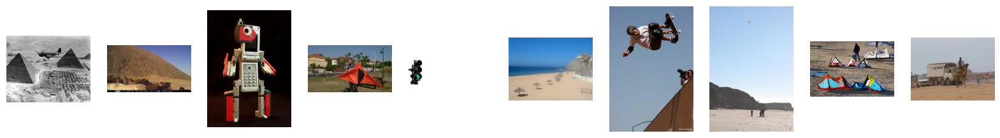

a plane flying over a pyramids and a city
a herd of horses standing in a desert
a toy robot with a cell phone in its hand
a man holding a kite in a park
a traffic light with a green light on it
a beach with umbrellas and chairs on it
a man flying through the air while riding a skateboard
a group of people standing on top of a sandy beach
a group of people standing on top of a sandy beach
a man riding a camel in front of a truck
Finding similar images for: 13_daisy_flower_move_this_flower_to_a_desert.jpeg


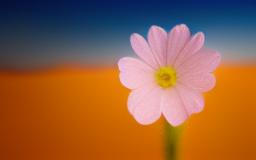

torch.Size([1, 768])


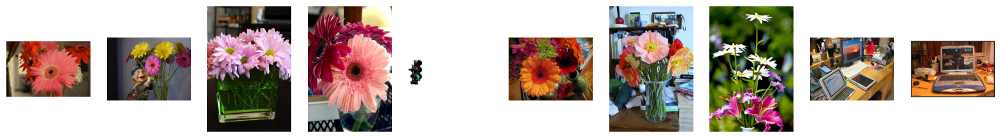

a vase with a bunch of flowers in it
a vase with a statue of a man holding a bouquet of flowers
a vase with pink flowers in it on a table
a vase with three flowers in it on a table
a traffic light with a green light on it
a vase filled with lots of colorful flowers
a vase of flowers on a table in a room
a vase with flowers in it sitting on a table
a desk with a laptop monitor and other electronics
a laptop computer sitting on top of a wooden desk
Finding similar images for: 14_cacti_add_tepals_to_the_cacti.jpeg


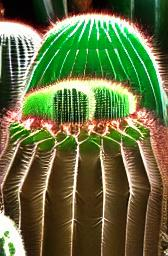

torch.Size([1, 768])


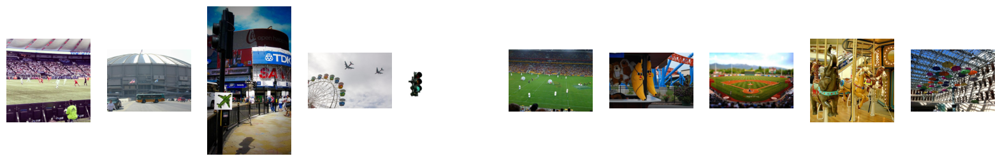

a soccer game is being played in a stadium
a bus is parked in front of a large building
a street scene with a sign on a pole
a ferris wheel and a plane flying in the sky
a traffic light with a green light on it
a large crowd of people watching a game
a bunch of bananas hanging from a stand
a baseball game is being played in a stadium
a carousel with a horse and a horse on it
a bunch of umbrellas hanging from the ceiling of a building
Finding similar images for: 15_scrambled_rubiks_cube_3_by_3_solve_this_Rubik's_cube.jpeg


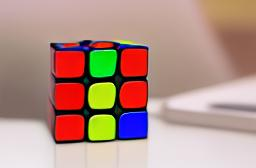

torch.Size([1, 768])


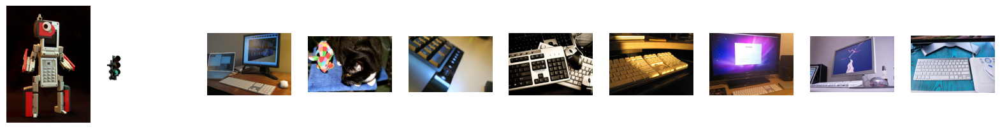

a toy robot with a cell phone in its hand
a traffic light with a green light on it
a computer monitor sitting on top of a wooden desk
a black and white cat playing with a toy
a close up of a keyboard on a desk
a computer keyboard and mouse sitting on a desk
a computer keyboard sitting on top of a desk
a computer monitor sitting on top of a wooden desk
a computer monitor sitting on top of a desk
a computer keyboard and mouse on a desk
Finding similar images for: 16_solved_rubiks_cube_2_by_2_make_this_Rubik's_cube_4_by_4_size.jpeg


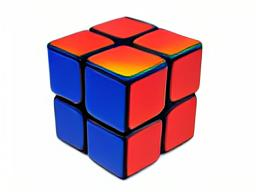

torch.Size([1, 768])


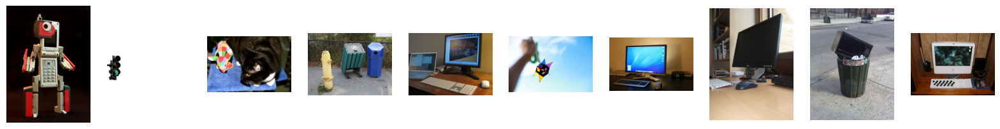

a toy robot with a cell phone in its hand
a traffic light with a green light on it
a black and white cat playing with a toy
three trash cans are sitting next to a fire hydrant
a computer monitor sitting on top of a wooden desk
a person holding a kite in the air
a computer monitor sitting on top of a desk
a computer monitor sitting on top of a wooden desk
a microwave sitting in a trash can on the side of the road
a computer monitor sitting on top of a wooden desk
Finding similar images for: 17_hot_air_balloon_over_water_at_night_put_the_hot_air_balloon_on_sand.jpeg


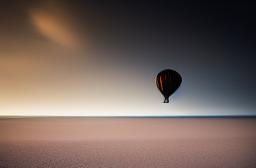

torch.Size([1, 768])


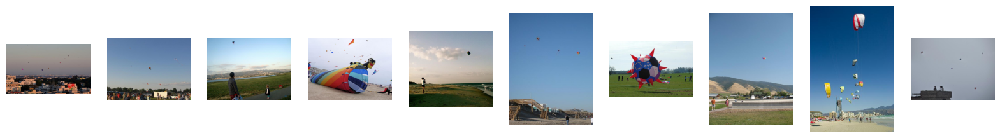

a city with a lot of buildings and kites flying in the sky
a crowd of people standing on top of a lush green field
a man and a child flying a kite in a field
a large colorful kite is being flown on the beach
a person flying a kite on a beach
a group of people flying kites on a beach
a large inflatable soccer ball in a field
a group of people flying a kite in a field
a group of people flying kites on a beach
a group of people standing on top of a building
Finding similar images for: 18_many_hot_air_balloons_show_only_one_white_and_red_hot_air_balloon.jpeg


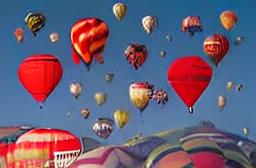

torch.Size([1, 768])


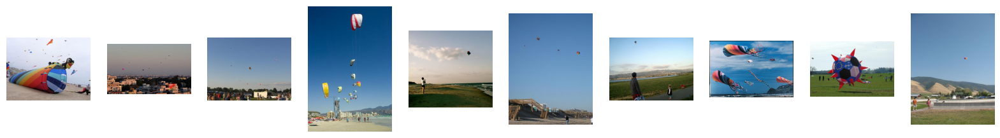

a large colorful kite is being flown on the beach
a city with a lot of buildings and kites flying in the sky
a crowd of people standing on top of a lush green field
a group of people flying kites on a beach
a person flying a kite on a beach
a group of people flying kites on a beach
a man and a child flying a kite in a field
a group of kites flying in the air on a beach
a large inflatable soccer ball in a field
a group of people flying a kite in a field
Finding similar images for: 19_tullamore_dew_bottle_with_two_glasses_make_this_jack_Daniels_whiskey_instead.jpeg


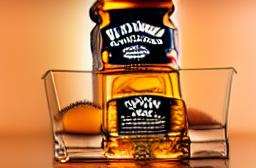

torch.Size([1, 768])


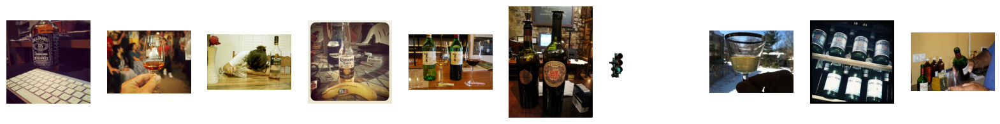

a bottle of jack daniels whiskey next to a keyboard
a person holding a wine glass in front of a crowd
a woman is sitting at a table with a bottle of alcohol
a bottle of coronano extra sitting on a table
three wine bottles and two glasses on a table
two bottles of wine sitting on a table
a traffic light with a green light on it
a person holding a wine glass in their hand
a bunch of bottles of wine are on a shelf
a man pouring a glass of wine into a wine glass
Finding similar images for: 20_full_beer_glass_make_this_beer_glass_half_empty.jpeg


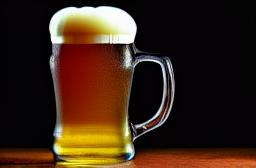

torch.Size([1, 768])


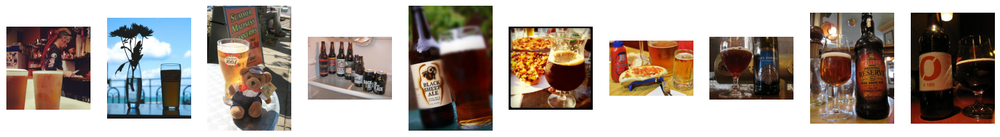

two cups of beer on a counter with a man in the background
a glass of beer and a vase with flowers
a teddy bear sitting on a table next to a glass of beer
a refrigerator filled with lots of different types of beer
a bottle of beer next to a glass of beer
a glass of beer sitting next to a plate of pizza
a hot dog with tomatoes and a drink on a table
a glass of beer next to a bottle of beer
a bottle of beer and a glass of beer
a bottle of wine and a glass of wine
Finding similar images for: 21_red_ferrari_make_this_ferrari_yellow.jpeg


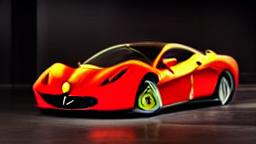

torch.Size([1, 768])


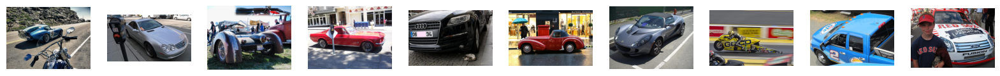

a blue sports car driving down a road next to a motorcycle
a silver mercedes parked next to a parking meter
a car with a large tire parked in a field
a red car parked next to a parking meter
a cat laying on the ground next to a parked car
a red car parked on the side of a street
a silver sports car parked in a parking lot
a person riding a motorcycle on a track
a blue truck with a number 2 on the bed
a boy in a red sox shirt and a baseball cap stands in front of a
Finding similar images for: 22_yellow_lamborghini_make_this_lamborghini_a_faster_model.jpeg


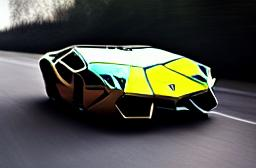

torch.Size([1, 768])


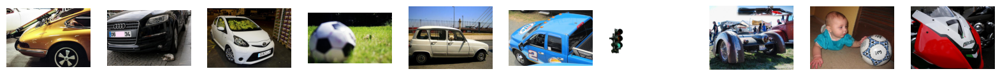

a car with a ski rack on the back of it
a cat laying on the ground next to a parked car
a small white car with a bunch of bananas in the back
a soccer ball sitting in the grass in front of a forest
a small white car with a dog in the window
a blue truck with a number 2 on the bed
a traffic light with a green light on it
a car with a large tire parked in a field
a baby laying on the floor with a soccer ball
a close up of a motorcycle with a red and white front
Finding similar images for: 23_fluffy_fox_dog_remove_the_fur_from_this_dog.jpeg


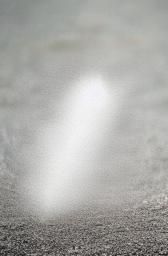

torch.Size([1, 768])


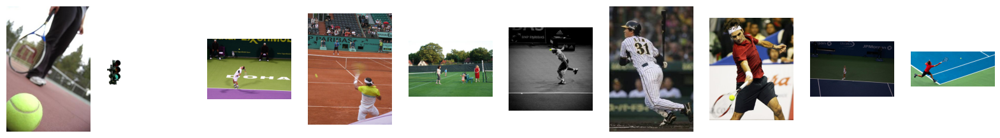

a tennis ball and racket on a court
a traffic light with a green light on it
a man is playing tennis on a court
a man hitting a tennis ball with a racquet
a group of people standing on a tennis court
a man holding a tennis racquet on a tennis court
a baseball player is running to first base
a man swinging a tennis racquet at a ball
a woman is playing tennis on a blue court
a man is playing tennis on a blue court
Finding similar images for: 24_pug_smiling_on_grass_make_this_pug_darker_fur_and_smile_less.jpeg


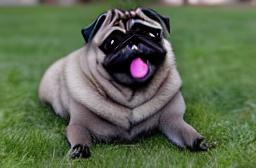

torch.Size([1, 768])


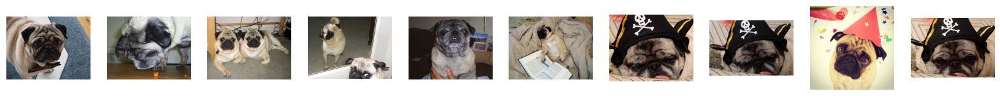

a small dog standing on a rug on a wooden floor
a pug dog eating carrots on the floor
two pug dogs laying under a desk under a desk
a dog looking at itself in a mirror
a person holding a small dog on a couch
a pug dog laying on a bed with a book
a pug dog wearing a pirate hat and sleeping on a bed
a pug dog wearing a pirate hat and tongue sticking out
a pug dog wearing a party hat with confetti
a pug dog wearing a pirate hat and tongue sticking out


In [25]:

###########################
# GET NEAREST IMAGES TO DIFFUSED IMAGES
# GET CAPTIONS FOR NEAREST IMAGES
###########################
# Find the most similar images to the output images
# Get the embeddings for the output images
diffused_images_folder = "./diffused_images"
nearest_results_diffused_captions_file = "./captions/nearest_results_diffused_captions.txt"
how_many_results = 10

# Save the captions to a file
with open(nearest_results_diffused_captions_file, 'w') as f:
    for image_name in [ x for x in sorted(os.listdir(diffused_images_folder)) if ".DS_Store" not in x ]:
        print("Finding similar images for: " + image_name)
        image = Image.open(os.path.join(diffused_images_folder,image_name))
        display(image)
        pix2pix_embedding = get_embeddings(image)
        pix2pix_scores, pix2pix_sample = get_nearest_examples(pix2pix_embedding, how_many=how_many_results)
        plot_nearest_samples(pix2pix_sample, how_many=how_many_results)

    
        # Get the captions for the output images
        for result in pix2pix_sample['image']:
            # print(result)
            image_caption = predict_caption_blip(result)
            print(image_caption)

            # Save the captions to a file
            f.write(image_caption)
            f.write("\n")

Finding similar images for: 01_black_cat.jpg


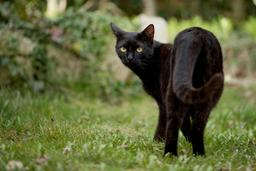

torch.Size([1, 768])


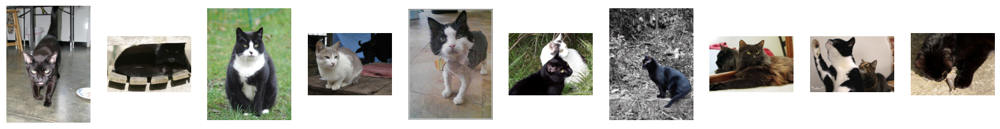

a black cat walking on a floor next to a plate
a black cat laying on a wooden bench
a black and white cat sitting in the grass
a cat sitting on a table next to a cow
a cat with a tie on standing on a tiled floor
two cats sitting in the grass near each other
a black cat sitting on a dirt ground
a cat laying on the floor looking at its reflection in a mirror
a cat is reaching up to a cat
a black cat is laying on the ground
Finding similar images for: 02_elephant_on_safari.jpg


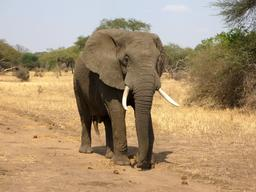

torch.Size([1, 768])


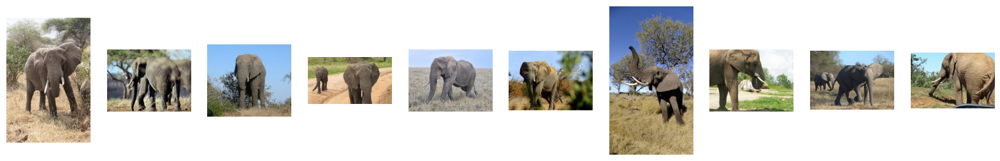

an elephant standing in a field with trees in the background
two elephants walking in a field with trees in the background
an elephant standing in a field with trees in the background
two elephants walking down a dirt road in the wild
a large elephant walking across a dry grass field
an elephant walking through a field with trees in the background
an elephant standing in a field with trees in the background
an elephant standing in a field with a ball
two elephants walking in a field with trees in the background
an elephant is walking in the dirt near a car
Finding similar images for: 03_old_abandoned_car.jpg


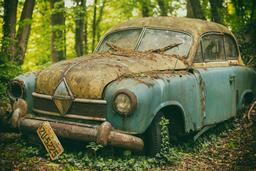

torch.Size([1, 768])


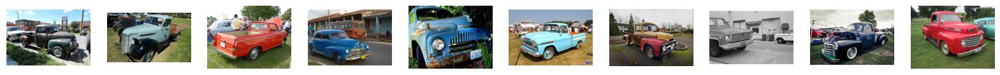

an old truck parked on the side of the road
a blue truck parked in a field with other cars
a red truck parked in a field with people standing around
a blue car is parked on the side of the road
an old blue truck is parked in the grass
a blue truck parked in a field with people standing around
an old truck is parked in a parking lot
a truck parked on the side of a road
a truck with a hood up parked in a field
a red truck parked in a field next to a blue car
Finding similar images for: 04_green_vintage_racecar.jpg


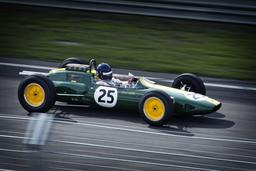

torch.Size([1, 768])


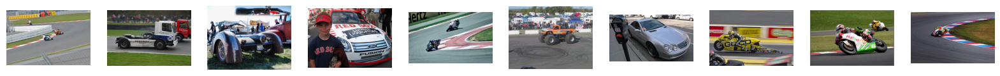

a group of motorcyclists racing around a track
a truck with a race car in the back
a car with a large tire parked in a field
a boy in a red sox shirt and a baseball cap stands in front of a
two people racing motorcycles on a track
a monster truck is driving through a circle of tires
a silver mercedes parked next to a parking meter
a person riding a motorcycle on a track
a person riding a motorcycle on a race track
a person riding a motorcycle on a race track
Finding similar images for: 05_man_wearing_white_t-shirt.jpg


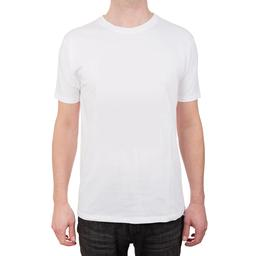

torch.Size([1, 768])


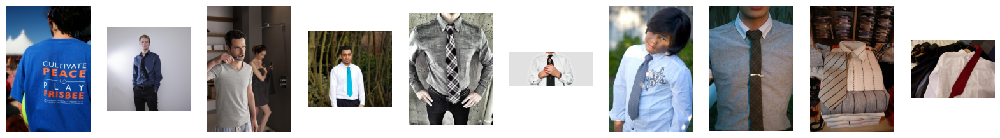

a man in a blue shirt is standing in front of a crowd
a man in a blue shirt and black tie
a man brushing his teeth in front of a woman
a man in a white shirt and blue tie
a man wearing a tie and jeans standing in front of a wall
a man in a white shirt and tie with a rose in his lap
a young boy wearing a white shirt and a tie
a man wearing a tie with a tie bar
a pile of folded shirts and ties on a table
a shirt and tie are laying on a bed
Finding similar images for: 06_red_tall_converse.jpg


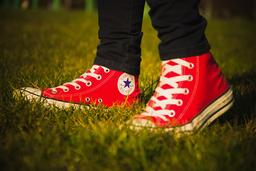

torch.Size([1, 768])


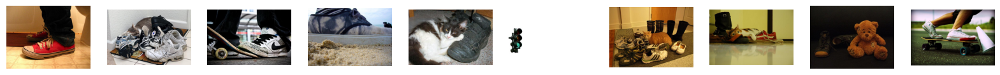

a person standing on a toilet with red shoes
a cat laying on a mat next to a pile of shoes
a person standing on a skateboard with a shoe on it
a pair of shoes sitting on top of a sandy beach
a cat laying on a pair of shoes
a traffic light with a green light on it
a cat laying on the floor next to a pile of shoes
a cat laying on a pair of shoes
a teddy bear sitting next to a pair of shoes
a person riding a skateboard with a cone on the side
Finding similar images for: 07_hand_holding_iphone.jpg


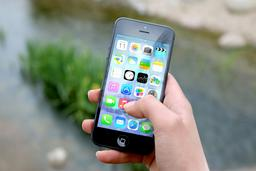

torch.Size([1, 768])


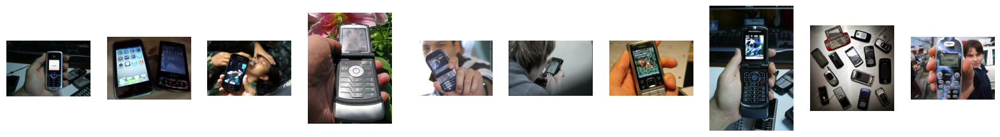

a person holding a cell phone in their hand
a couple of cell phones sitting next to each other
a woman is holding a cell phone up to her face
a person holding a cell phone in their hand
a man holding a cell phone in his hand
a person holding a cell phone in their hand
a person holding a cell phone in their hand
a person holding a cell phone in their hand
a table with a bunch of different cell phones
a person holding a cell phone in their hand
Finding similar images for: 08_opened_laptop_on_a_table.jpg


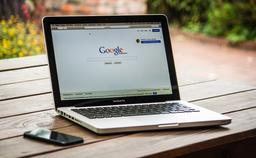

torch.Size([1, 768])


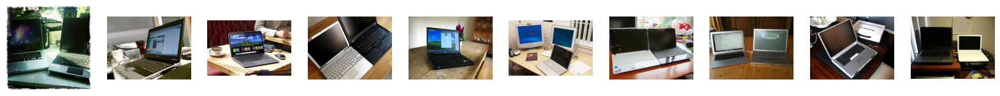

two laptops sitting on a table with a coffee cup
a laptop computer sitting on top of a desk
a laptop computer sitting on top of a wooden table
two laptops sitting on a wooden table
a laptop computer sitting on top of a wooden table
a desk with a laptop monitor and other electronics
two laptops sitting on a desk with a window in the background
two laptops sitting on a wooden table
a laptop computer sitting on top of a wooden table
a desk with two laptops and a mouse
Finding similar images for: 09_katana_in_a_sheath.jpg


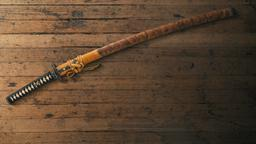

torch.Size([1, 768])


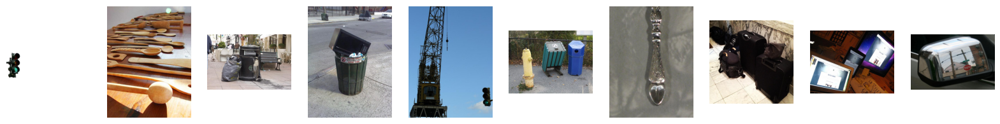

a traffic light with a green light on it
a table with a bunch of wooden spoons and spoons
a trash can and trash bag on a sidewalk
a microwave sitting in a trash can on the side of the road
a crane is lifting a traffic light in the air
three trash cans are sitting next to a fire hydrant
a spoon with a flower on it sitting on a table
a couple of suitcases sitting on the floor
a desk with three computers and a laptop
a stop sign is reflected in a car mirror
Finding similar images for: 10_hand_holding_a_gun.jpg


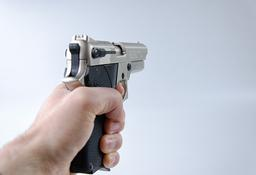

torch.Size([1, 768])


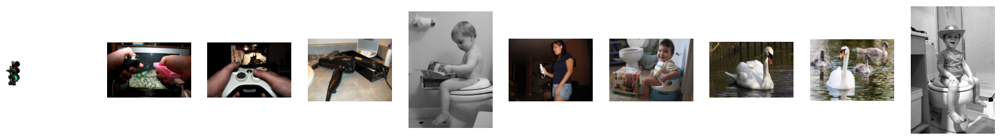

a traffic light with a green light on it
two people holding remote controls in front of a tv
a person holding a video game controller in front of a tv
a hair dryer and a box on a counter
a baby sitting on a toilet reading a book
a woman standing in a living room holding a nintendo wii game controller
a baby sitting on a potty seat in a bathroom
a white swan is swimming in the water
a swan and her babies swimming in a pond
a little boy sitting on a toilet in a bathroom
Finding similar images for: 11_eiffel_tower_in_daylight.jpg


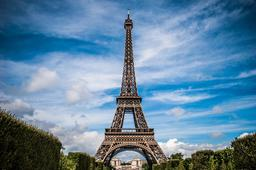

torch.Size([1, 768])


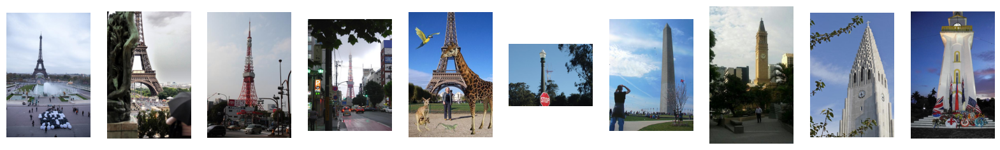

a group of people standing around a fountain
a person holding an umbrella in front of the eiffel tower
a tall tower sitting above a city street
a city street with cars and people walking on the sidewalk
a giraffe and a kangaroo are standing in front of the eiffel
a stop sign is shown on a street light
a woman standing in front of a tall monument
a man walking in a park with a clock tower in the background
a tall building with a clock on the front of it
a white tower with a clock on top of it
Finding similar images for: 12_pyramid_in_a_desert.jpg


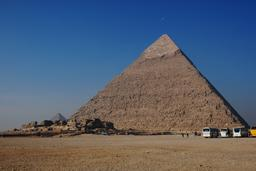

torch.Size([1, 768])


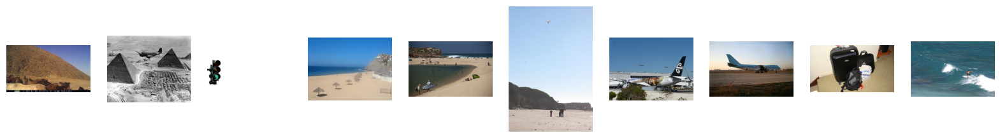

a herd of horses standing in a desert
a plane flying over a pyramids and a city
a traffic light with a green light on it
a beach with umbrellas and chairs on it
a group of people on a beach with a surfboard
a group of people standing on top of a sandy beach
a large jetliner sitting on top of an airport tarmac
a large passenger jet sitting on top of an airport runway
a black suitcase and a black backpack on the floor
a man riding a wave on top of a surfboard
Finding similar images for: 13_daisy_flower.jpg


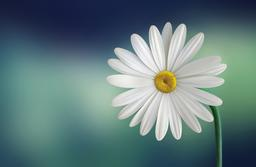

torch.Size([1, 768])


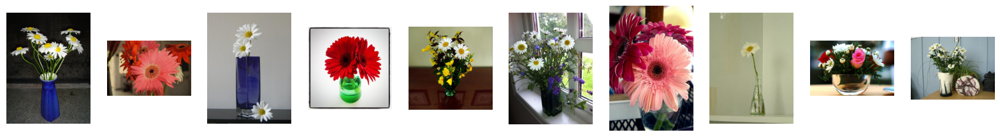

a blue vase with white daisies in it
a vase with a bunch of flowers in it
a blue vase with two white flowers in it
two red flowers in a green vase on a white surface
a vase of flowers on a table
a vase of flowers sitting on a window sill
a vase with three flowers in it on a table
a single flower in a glass vase on a shelf
a vase with flowers in it on a table
a vase with flowers and a rock on a table
Finding similar images for: 14_cacti.jpg


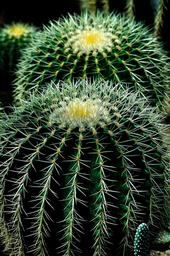

torch.Size([1, 768])


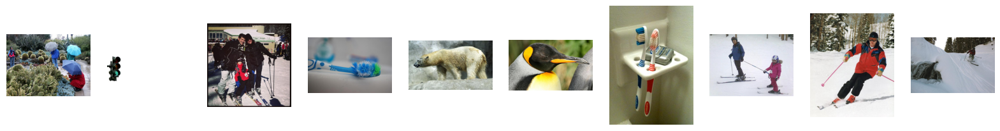

a group of people standing around a cactus garden
a traffic light with a green light on it
a man and two children on skis posing for a picture
a toothbrush with a blue bristles and green bristles
a polar bear standing on a rock in a zoo
a close up of a penguin with a yellow beak
a toothbrush holder with toothpaste and tooth paste
a man and a little girl on skis
a man riding skis down a snow covered slope
a man riding skis down a snow covered slope
Finding similar images for: 15_scrambled_rubiks_cube_3_by_3.jpg


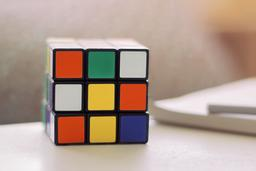

torch.Size([1, 768])


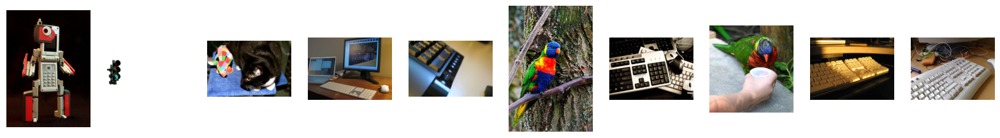

a toy robot with a cell phone in its hand
a traffic light with a green light on it
a black and white cat playing with a toy
a computer monitor sitting on top of a wooden desk
a close up of a keyboard on a desk
a colorful bird sitting on a tree branch
a computer keyboard and mouse sitting on a desk
a colorful bird is drinking from a cup
a computer keyboard sitting on top of a desk
a computer keyboard sitting on top of a wooden desk
Finding similar images for: 16_solved_rubiks_cube_2_by_2.jpg


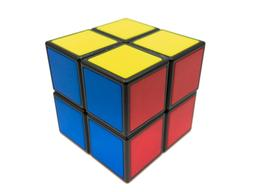

torch.Size([1, 768])


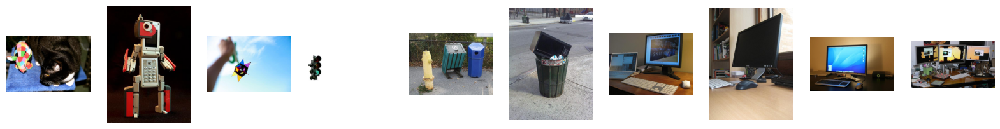

a black and white cat playing with a toy
a toy robot with a cell phone in its hand
a person holding a kite in the air
a traffic light with a green light on it
three trash cans are sitting next to a fire hydrant
a microwave sitting in a trash can on the side of the road
a computer monitor sitting on top of a wooden desk
a computer monitor sitting on top of a wooden desk
a computer monitor sitting on top of a desk
a desk with three computer monitors and a cat
Finding similar images for: 17_hot_air_balloon_over_water_at_night.jpg


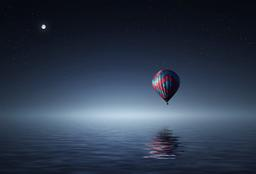

torch.Size([1, 768])


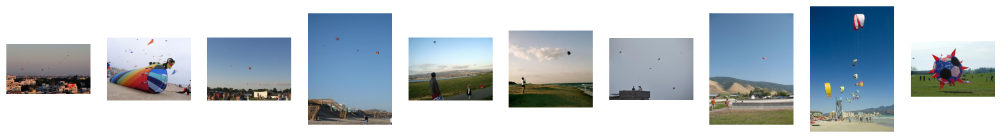

a city with a lot of buildings and kites flying in the sky
a large colorful kite is being flown on the beach
a crowd of people standing on top of a lush green field
a group of people flying kites on a beach
a man and a child flying a kite in a field
a person flying a kite on a beach
a group of people standing on top of a building
a group of people flying a kite in a field
a group of people flying kites on a beach
a large inflatable soccer ball in a field
Finding similar images for: 18_many_hot_air_balloons.jpg


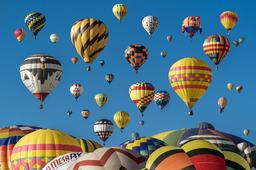

torch.Size([1, 768])


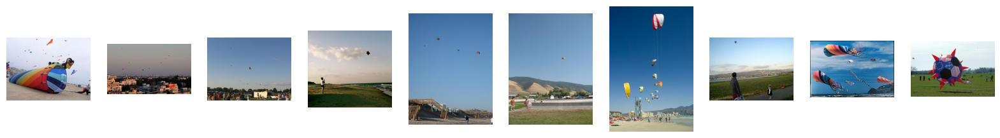

a large colorful kite is being flown on the beach
a city with a lot of buildings and kites flying in the sky
a crowd of people standing on top of a lush green field
a person flying a kite on a beach
a group of people flying kites on a beach
a group of people flying a kite in a field
a group of people flying kites on a beach
a man and a child flying a kite in a field
a group of kites flying in the air on a beach
a large inflatable soccer ball in a field
Finding similar images for: 19_tullamore_dew_bottle_with_two_glasses.jpg


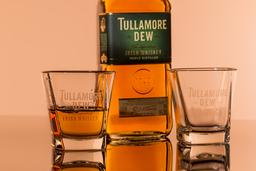

torch.Size([1, 768])


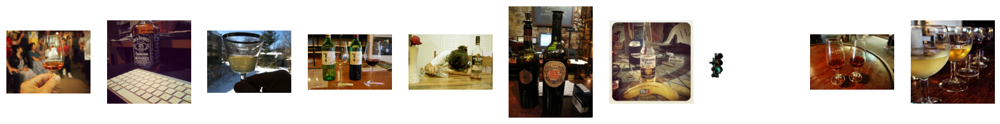

a person holding a wine glass in front of a crowd
a bottle of jack daniels whiskey next to a keyboard
a person holding a wine glass in their hand
three wine bottles and two glasses on a table
a woman is sitting at a table with a bottle of alcohol
two bottles of wine sitting on a table
a bottle of coronano extra sitting on a table
a traffic light with a green light on it
two glasses of wine sitting on a table
a row of wine glasses on a table
Finding similar images for: 20_full_beer_glass.jpg


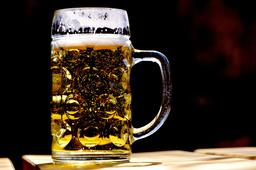

torch.Size([1, 768])


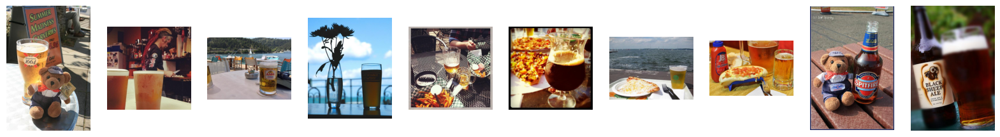

a teddy bear sitting on a table next to a glass of beer
two cups of beer on a counter with a man in the background
a table with two glasses of beer on it
a glass of beer and a vase with flowers
a table with a plate of food and a glass of beer
a glass of beer sitting next to a plate of pizza
a plate of pizza and a drink on a tray
a hot dog with tomatoes and a drink on a table
a teddy bear sitting next to a bottle of beer
a bottle of beer next to a glass of beer
Finding similar images for: 21_red_ferrari.jpg


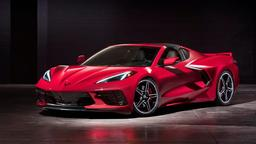

torch.Size([1, 768])


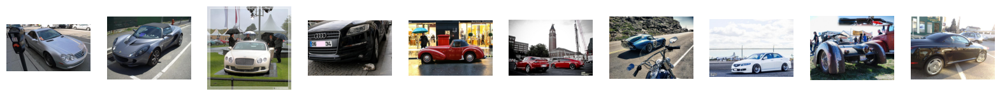

a silver mercedes parked next to a parking meter
a silver sports car parked in a parking lot
a car is parked in the rain with people holding umbrellas
a cat laying on the ground next to a parked car
a red car parked on the side of a street
two red cars parked in a parking lot
a blue sports car driving down a road next to a motorcycle
a white car parked in front of a fence
a car with a large tire parked in a field
a black sports car parked in a parking lot
Finding similar images for: 22_yellow_lamborghini.jpg


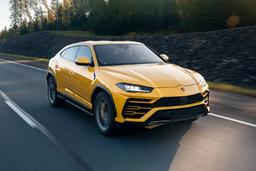

torch.Size([1, 768])


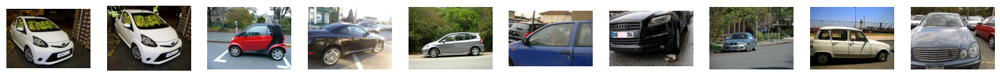

a small white car with a bunch of bananas in the back
a car with a bunch of bananas in the back
a small red car parked in a parking space
a black sports car parked in a parking lot
a small silver car parked on the side of the road
a dog sitting in the passenger seat of a blue car
a cat laying on the ground next to a parked car
a car parked on the side of a road
a small white car with a dog in the window
a blue mercedes parked in a parking lot
Finding similar images for: 23_fluffy_fox_dog.jpeg


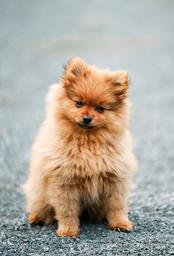

torch.Size([1, 768])


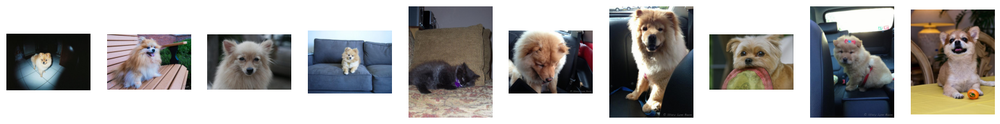

a dog standing on a tiled floor in a dark room
a small dog sitting on a wooden bench
a small dog with a long hair standing in front of a car
a small dog sitting on a couch in a room
a black cat laying on a couch with a purple collar
a dog sitting in a car with a laptop
a dog sitting in the back seat of a car
a dog holding a frisbee in its mouth
a small dog sitting on the back seat of a car
a small dog sitting on a table with a toy
Finding similar images for: 24_pug_smiling_on_grass.jpg


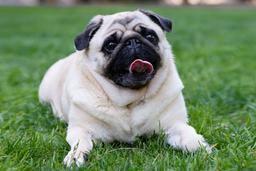

torch.Size([1, 768])


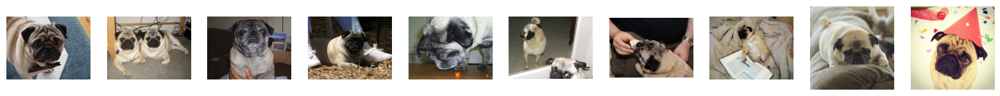

a small dog standing on a rug on a wooden floor
two pug dogs laying under a desk under a desk
a person holding a small dog on a couch
a pug dog laying on the ground next to a person
a pug dog eating carrots on the floor
a dog looking at itself in a mirror
a man is feeding a small dog a piece of food
a pug dog laying on a bed with a book
a pug dog laying on a couch with its head on the arm
a pug dog wearing a party hat with confetti


In [26]:
###########################
# GET NEAREST IMAGES TO ORIGINAL IMAGES
# GET CAPTIONS FOR NEAREST IMAGES
###########################

# Find the most similar images to the original images
# Get the embeddings for the original images
original_images_folder = "./resized_images"
nearest_results_original_captions_file = "./captions/nearest_results_original_captions.txt"
how_many_results = 10

# Save the captions to a file
with open(nearest_results_original_captions_file, 'w') as f:
    for image_name in [ x for x in sorted(os.listdir(original_images_folder)) if ".DS_Store" not in x ]:
        print("Finding similar images for: " + image_name)
        image = Image.open(os.path.join(original_images_folder,image_name))
        display(image)
        pix2pix_embedding = get_embeddings(image)
        pix2pix_scores, pix2pix_sample = get_nearest_examples(pix2pix_embedding, how_many=how_many_results)
        plot_nearest_samples(pix2pix_sample, how_many=how_many_results)


        # Get the captions for the output images
        for result in pix2pix_sample['image']:
            # print(result)
            image_caption = predict_caption_blip(result)
            print(image_caption)

            # Save the captions to a file
            f.write(image_caption)
            f.write("\n")

In [27]:
###########################
# COMPARE CAPTIONS
###########################

# Compare the captions for the original images and the nearest matches images
# Save the results to a file

# Get the captions for the original images
original_images_captions_file = "./captions/original_images_captions.txt"
original_images_captions = []
with open(original_images_captions_file, 'r') as f:
    for line in f:
        original_images_captions.append(line.strip())

# Get the captions for the nearest matches images
nearest_results_original_captions_file = "./captions/nearest_results_original_captions.txt"
nearest_results_original_captions = []
with open(nearest_results_original_captions_file, 'r') as f:
    for line in f:
        nearest_results_original_captions.append(line.strip())

# Get the captions for the diffused images
diffused_images_captions_file = "./captions/diffused_images_captions.txt"
diffused_images_captions = []
with open(diffused_images_captions_file, 'r') as f:
    for line in f:
        diffused_images_captions.append(line.strip())

# Get the captions for the nearest matches images for the diffused images
nearest_results_diffused_captions_file = "./captions/nearest_results_diffused_captions.txt"
nearest_results_diffused_captions = []
with open(nearest_results_diffused_captions_file, 'r') as f:
    for line in f:
        nearest_results_diffused_captions.append(line.strip())

# Now we have several things to compare using SENTENCE SIMILARITY:
# 1. The captions of the original images + the query text and the captions of the nearest matches images (every original image has 10 nearest matches)
# 2. The captions of the diffused images and the captions of the nearest matches images (every diffused image has 10 nearest matches)
# 3. The captions of the original images + the query text and the captions of the diffused images
# 4. The captions of the original images + the query text and the captions of the nearest matches images for the diffused images (every original image has 10 nearest matches)
# 5. The captions of the diffused images and the captions of the nearest matches images for the original images (every original image has 10 nearest matches)
# We want to save the results to a csv file







In [28]:
import numpy as np

In [29]:
# 1. The captions of the original images + the query text and the captions of the nearest matches images (every original image has 10 nearest matches)
# 1.1. The captions of the original images + the query text
original_images_captions_with_query = []
for index, original_image_caption in enumerate(original_images_captions):
    original_images_captions_with_query.append(original_image_caption + " " + prompts[index])

# Compare the captions of the original images + the query text and the captions of the nearest matches images
# Save the results to a file
maximum_similarities_list_0 = []
original_images_captions_with_query_nearest_results_original_captions_file = "./results/original_images_captions_with_query_nearest_results_original_captions.csv"
with open(original_images_captions_with_query_nearest_results_original_captions_file, 'w') as f:
    for index, original_image_caption_with_query in enumerate(original_images_captions_with_query):
        max_similarity_score_for_image = 0
        for nearest_result_original_caption in nearest_results_original_captions[index*10:(index+1)*10]:
            similarity_score = compare_captions(original_image_caption_with_query, nearest_result_original_caption)
            max_similarity_score_for_image = max(max_similarity_score_for_image, similarity_score)
            f.write(original_image_caption_with_query)
            f.write(",")
            f.write(nearest_result_original_caption)
            f.write(",")
            f.write(str(similarity_score))
            f.write("\n")
        print("Max similarity score for image " + str(index) + ": " + str(max_similarity_score_for_image))
        maximum_similarities_list_0.append(max_similarity_score_for_image)

print("Average of picture " , np.average(maximum_similarities_list_0))

Max similarity score for image 0: 0.64548659324646
Max similarity score for image 1: 0.8230800628662109
Max similarity score for image 2: 0.4077676236629486
Max similarity score for image 3: 0.4902650713920593
Max similarity score for image 4: 0.5023822784423828
Max similarity score for image 5: 0.43529948592185974
Max similarity score for image 6: 0.795330822467804
Max similarity score for image 7: 0.889227032661438
Max similarity score for image 8: 0.18895851075649261
Max similarity score for image 9: 0.3694356381893158
Max similarity score for image 10: 0.6101504564285278
Max similarity score for image 11: 0.453045129776001
Max similarity score for image 12: 0.4854283928871155
Max similarity score for image 13: 0.4380013048648834
Max similarity score for image 14: 0.37219515442848206
Max similarity score for image 15: 0.2155761569738388
Max similarity score for image 16: 0.5483043789863586
Max similarity score for image 17: 0.466541588306427
Max similarity score for image 18: 0.5306

In [30]:
# 2. The captions of the diffused images and the captions of the nearest matches images (every diffused image has 10 nearest matches)
# Compare the captions of the diffused images and the captions of the nearest matches images
# Save the results to a file
maximum_similarities_list_1 = []
diffused_images_captions_nearest_results_diffused_captions_file = "./results/diffused_images_captions_nearest_results_diffused_captions.csv"
with open(diffused_images_captions_nearest_results_diffused_captions_file, 'w') as f:
    for index, diffused_image_caption in enumerate(diffused_images_captions):
        max_similarity_score_for_image = 0
        for nearest_result_diffused_caption in nearest_results_diffused_captions[index*10:(index+1)*10]:
            similarity_score = compare_captions(diffused_image_caption, nearest_result_diffused_caption)
            max_similarity_score_for_image = max(max_similarity_score_for_image, similarity_score)
            f.write(diffused_image_caption)
            f.write(",")
            f.write(nearest_result_diffused_caption)
            f.write(",")
            f.write(str(similarity_score))
            f.write("\n")
        print("Max similarity score for image " + str(index) + ": " + str(max_similarity_score_for_image))
        maximum_similarities_list_1.append(max_similarity_score_for_image)
        
print("Average of picture " , np.average(maximum_similarities_list_1))


Max similarity score for image 0: 0.6803773045539856
Max similarity score for image 1: 0.602776825428009
Max similarity score for image 2: 0.5471147894859314
Max similarity score for image 3: 0.5160686373710632
Max similarity score for image 4: 0.7530723214149475
Max similarity score for image 5: 0.516606330871582
Max similarity score for image 6: 0.6769943833351135
Max similarity score for image 7: 0.8761657476425171
Max similarity score for image 8: 0.4348096251487732
Max similarity score for image 9: 0.5463801026344299
Max similarity score for image 10: 0.5192134976387024
Max similarity score for image 11: 0.5176428556442261
Max similarity score for image 12: 0.9313436150550842
Max similarity score for image 13: 0.32892605662345886
Max similarity score for image 14: 0.4608762264251709
Max similarity score for image 15: 0.2941489517688751
Max similarity score for image 16: 0.6543880701065063
Max similarity score for image 17: 0.5766503214836121
Max similarity score for image 18: 0.70

In [31]:
# 3. The captions of the original images + the query text and the captions of the diffused images
# Compare the captions of the original images + the query text and the captions of the diffused images
# Save the results to a file
maximum_similarities_list_2 = []
original_images_captions_with_query_diffused_images_captions_file = "./results/original_images_captions_with_query_diffused_images_captions.csv"
with open(original_images_captions_with_query_diffused_images_captions_file, 'w') as f:
    for index, original_image_caption_with_query in enumerate(original_images_captions_with_query):
        similarity_score = compare_captions(original_image_caption_with_query, diffused_images_captions[index])
        f.write(original_image_caption_with_query)
        f.write(",")
        f.write(diffused_images_captions[index])
        f.write(",")
        f.write(str(similarity_score))
        f.write("\n")
        print("Similarity score for image " + str(index) + ": " + str(similarity_score))
        maximum_similarities_list_2.append(max_similarity_score_for_image)

print("Average of picture " , np.average(maximum_similarities_list_2))
    

Similarity score for image 0: 0.7649635076522827
Similarity score for image 1: 0.43255314230918884
Similarity score for image 2: 0.763260543346405
Similarity score for image 3: 0.808529257774353
Similarity score for image 4: 0.5518410205841064
Similarity score for image 5: 0.7157077193260193
Similarity score for image 6: 0.5301799178123474
Similarity score for image 7: 0.754346489906311
Similarity score for image 8: 0.3121964931488037
Similarity score for image 9: 0.8561873435974121
Similarity score for image 10: 0.568306565284729
Similarity score for image 11: 0.7687745094299316
Similarity score for image 12: 0.41446632146835327
Similarity score for image 13: 0.5812802910804749
Similarity score for image 14: 0.90700364112854
Similarity score for image 15: 0.8189352750778198
Similarity score for image 16: 0.8376768231391907
Similarity score for image 17: 0.7642196416854858
Similarity score for image 18: 0.6049335598945618
Similarity score for image 19: 0.8080923557281494
Similarity sco

In [32]:
# 4. The captions of the original images + the query text and the captions of the nearest matches images for the diffused images (every original image has 10 nearest matches)
# Compare the captions of the original images + the query text and the captions of the nearest matches images for the diffused images
# Save the results to a file
maximum_similarities_list_3 = []
original_images_captions_with_query_nearest_results_diffused_captions_file = "./results/original_images_captions_with_query_nearest_results_diffused_captions.csv"
with open(original_images_captions_with_query_nearest_results_diffused_captions_file, 'w') as f:
    for index, original_image_caption_with_query in enumerate(original_images_captions_with_query):
        max_similarity_score_for_image = 0
        for nearest_result_diffused_caption in nearest_results_diffused_captions[index*10:(index+1)*10]:
            similarity_score = compare_captions(original_image_caption_with_query, nearest_result_diffused_caption)
            max_similarity_score_for_image = max(max_similarity_score_for_image, similarity_score)
            f.write(original_image_caption_with_query)
            f.write(",")
            f.write(nearest_result_diffused_caption)
            f.write(",")
            f.write(str(similarity_score))
            f.write("\n")
        print("Max similarity score for image " + str(index) + ": " + str(max_similarity_score_for_image))
        maximum_similarities_list_3.append(max_similarity_score_for_image)

print("Average of picture " , np.average(maximum_similarities_list_3))
        

Max similarity score for image 0: 0.6292316913604736
Max similarity score for image 1: 0.6552553772926331
Max similarity score for image 2: 0.3718613386154175
Max similarity score for image 3: 0.4902650713920593
Max similarity score for image 4: 0.5023822784423828
Max similarity score for image 5: 0.43529948592185974
Max similarity score for image 6: 0.795330822467804
Max similarity score for image 7: 0.889227032661438
Max similarity score for image 8: 0.20446066558361053
Max similarity score for image 9: 0.4695706069469452
Max similarity score for image 10: 0.6101504564285278
Max similarity score for image 11: 0.5962857007980347
Max similarity score for image 12: 0.40550848841667175
Max similarity score for image 13: 0.15937668085098267
Max similarity score for image 14: 0.3637959361076355
Max similarity score for image 15: 0.18634715676307678
Max similarity score for image 16: 0.5483043789863586
Max similarity score for image 17: 0.466541588306427
Max similarity score for image 18: 0

In [33]:
# 5. The captions of the diffused images and the captions of the nearest matches images for the original images (every original image has 10 nearest matches)
# Compare the captions of the diffused images and the captions of the nearest matches images for the original images
# Save the results to a file
maximum_similarities_list_4 = []
diffused_images_captions_nearest_results_original_captions_file = "./results/diffused_images_captions_nearest_results_original_captions.csv"
with open(diffused_images_captions_nearest_results_original_captions_file, 'w') as f:
    for index, diffused_image_caption in enumerate(diffused_images_captions):
        max_similarity_score_for_image = 0
        for nearest_result_original_caption in nearest_results_original_captions[index*10:(index+1)*10]:
            similarity_score = compare_captions(diffused_image_caption, nearest_result_original_caption)
            max_similarity_score_for_image = max(max_similarity_score_for_image, similarity_score)
            f.write(diffused_image_caption)
            f.write(",")
            f.write(nearest_result_original_caption)
            f.write(",")
            f.write(str(similarity_score))
            f.write("\n")
        print("Max similarity score for image " + str(index) + ": " + str(max_similarity_score_for_image))
        maximum_similarities_list_4.append(max_similarity_score_for_image)

print("Average of picture " , np.average(maximum_similarities_list_4))

Max similarity score for image 0: 0.6803773045539856
Max similarity score for image 1: 0.6287172436714172
Max similarity score for image 2: 0.641726016998291
Max similarity score for image 3: 0.5160686373710632
Max similarity score for image 4: 0.7530723214149475
Max similarity score for image 5: 0.516606330871582
Max similarity score for image 6: 0.6769943833351135
Max similarity score for image 7: 0.8761657476425171
Max similarity score for image 8: 0.2630554139614105
Max similarity score for image 9: 0.42720356583595276
Max similarity score for image 10: 0.5950007438659668
Max similarity score for image 11: 0.4281288981437683
Max similarity score for image 12: 0.8342568278312683
Max similarity score for image 13: 0.3487418293952942
Max similarity score for image 14: 0.4775311052799225
Max similarity score for image 15: 0.2941489517688751
Max similarity score for image 16: 0.6543880701065063
Max similarity score for image 17: 0.5766503214836121
Max similarity score for image 18: 0.70

In [34]:
import pandas as pd
# read the files with the results
original_images_captions_with_query_diffused_images_captions = pd.read_csv(original_images_captions_with_query_diffused_images_captions_file, header=None)
original_images_captions_with_query_nearest_results_diffused_captions = pd.read_csv(original_images_captions_with_query_nearest_results_diffused_captions_file, header=None)
diffused_images_captions_nearest_results_original_captions = pd.read_csv(diffused_images_captions_nearest_results_original_captions_file, header=None)
original_images_captions_with_query_nearest_results_original_captions = pd.read_csv(original_images_captions_with_query_nearest_results_original_captions_file, header=None)
diffused_images_captions_nearest_results_diffused_captions = pd.read_csv(diffused_images_captions_nearest_results_diffused_captions_file, header=None)

# for every file create a list for storing if the results are relevant or not
# the results are in the last column
# for every file results go over the lines
# if the similarity score is bigger than 0.5 then the result is relevant and we add 1 to the list otehrwise we add 0




In [35]:
def create_relevant_list(dataframe):
    relevant_list = []
    for index, row in dataframe.iterrows():
        if row[2] > 0.5:
            relevant_list.append(1)
        else:
            relevant_list.append(0)
    return relevant_list

def get_first_index_of_relevant_result(relevant_results):
    relevant_results_first_index = []
    for index, element in enumerate(relevant_results):
        if index % 10 == 0:
            if 1 in relevant_results[index:index+10]:
                relevant_results_first_index.append(relevant_results[index:index+10].index(1)+1)
            else:
                relevant_results_first_index.append(0)
    return relevant_results_first_index

def calculate_mrr(ranks):
    mrr = 0
    for rank in ranks:
        if rank > 0:
            mrr += 1.0 / rank
    mrr /= len(ranks)
    return mrr

In [60]:

# original_images_captions_with_query_diffused_images_captions_relevant = []
# rel_1 = create_relevant_list(original_images_captions_with_query_diffused_images_captions)
# print(rel_1)
# indexes_1 = get_first_index_of_relevant_result(rel_1)


original_images_captions_with_query_nearest_results_original_captions_relevant = []
rel_2 = create_relevant_list(original_images_captions_with_query_nearest_results_original_captions)
print(rel_2)
indexes_2 = get_first_index_of_relevant_result(rel_2)

original_images_captions_with_query_nearest_results_diffused_captions_relevant = []
rel_3 = create_relevant_list(original_images_captions_with_query_nearest_results_diffused_captions)
print(rel_3)
indexes_3 = get_first_index_of_relevant_result(rel_3)


diffused_images_captions_nearest_results_original_captions_relevant = []
rel_4 = create_relevant_list(diffused_images_captions_nearest_results_original_captions)
print(rel_4)
indexes_4 = get_first_index_of_relevant_result(rel_4)

diffused_images_captions_nearest_results_diffused_captions_relevant = []
rel_5 = create_relevant_list(diffused_images_captions_nearest_results_diffused_captions)
print(rel_5)
indexes_5 = get_first_index_of_relevant_result(rel_5)

# print("indexes_1: " + str(indexes_1))
print("indexes_2: " + str(indexes_2))
print("indexes_3: " + str(indexes_3))
print("indexes_4: " + str(indexes_4))
print("indexes_5: " + str(indexes_5))

[0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1]
[1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [61]:
# mrr_1 = calculate_mrr(indexes_1)
mrr_2 = calculate_mrr(indexes_2)
mrr_3 = calculate_mrr(indexes_3)
mrr_4 = calculate_mrr(indexes_4)
mrr_5 = calculate_mrr(indexes_5)

# print("MRR for original images captions with query and diffused images captions: " + str(mrr_1))
print("MRR for original images captions with query and nearest results original captions: " + str(mrr_2))
print("MRR for original images captions with query and nearest results diffused captions: " + str(mrr_3))
print("MRR for diffused images captions and nearest results original captions: " + str(mrr_4))
print("MRR for diffused images captions and nearest results diffused captions: " + str(mrr_5))

MRR for original images captions with query and nearest results original captions: 0.2916666666666667
MRR for original images captions with query and nearest results diffused captions: 0.26921296296296293
MRR for diffused images captions and nearest results original captions: 0.46805555555555545
MRR for diffused images captions and nearest results diffused captions: 0.47261904761904755


In [62]:
# write out Mean Average Precision (MAP) algorithm

def calculate_map(relevant_results):
    map = 0
    for index, element in enumerate(relevant_results):
        if index % 10 == 0:
            sum = 0
            for i in range(10):
                if relevant_results[index+i] == 1:
                    sum += 1
            map += sum / (index+1)
    map /= len(relevant_results)
    return map

In [63]:
# map_1 = calculate_map(rel_1)
map_2 = calculate_map(rel_2)
map_3 = calculate_map(rel_3)
map_4 = calculate_map(rel_4)
map_5 = calculate_map(rel_5)

# print("MAP for original images captions with query and diffused images captions: " + str(map_1))
print("MAP for original images captions with query and nearest results original captions: " + str(map_2))
print("MAP for original images captions with query and nearest results diffused captions: " + str(map_3))
print("MAP for diffused images captions and nearest results original captions: " + str(map_4))
print("MAP for diffused images captions and nearest results diffused captions: " + str(map_5))


MAP for original images captions with query and nearest results original captions: 0.030105998429930045
MAP for original images captions with query and nearest results diffused captions: 0.02346190403915305
MAP for diffused images captions and nearest results original captions: 0.042346032790929834
MAP for diffused images captions and nearest results diffused captions: 0.04171545644218477


In [64]:
#write out and NGCG algorithm for the results
import math

# create the dcg function
def calculate_dcg(relevant_results):
    dcg = 0
    for index, element in enumerate(relevant_results):
        if index % 10 == 0:
            dcg += element / math.log(1+index+1, 2)
    return dcg

# create the idcg function
def calculate_idcg(relevant_results):
    idcg = 0
    for index, element in enumerate(relevant_results):
        if index % 10 == 0:
            idcg += 1 / math.log(1+index+1, 2)
    return idcg

# create the ngcg function
def calculate_ngcg(relevant_results):
    dcg = calculate_dcg(relevant_results)
    idcg = calculate_idcg(relevant_results)
    return dcg / idcg


In [66]:
# ndcg_1 = calculate_ngcg(rel_1)
ndcg_2 = calculate_ngcg(rel_2)
ndcg_3 = calculate_ngcg(rel_3)
ndcg_4 = calculate_ngcg(rel_4)
ndcg_5 = calculate_ngcg(rel_5)

# print("NDCG for original images captions with query and diffused images captions: " + str(ndcg_1))
print("NDCG for original images captions with query and nearest results original captions: " + str(ndcg_2))
print("NDCG for original images captions with query and nearest results diffused captions: " + str(ndcg_3))
print("NDCG for diffused images captions and nearest results original captions: " + str(ndcg_4))
print("NDCG for diffused images captions and nearest results diffused captions: " + str(ndcg_5))


NDCG for original images captions with query and nearest results original captions: 0.1604526747585597
NDCG for original images captions with query and nearest results diffused captions: 0.3460236221809344
NDCG for diffused images captions and nearest results original captions: 0.4895035195618384
NDCG for diffused images captions and nearest results diffused captions: 0.5105119011310899
